## Homework 1: Dataset Wine quality

# **Required Libraries**

In [48]:
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import math
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from scipy.stats import skew

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


# **Palette Setup**

In [10]:
# Defining palette
colors = ["#9467bd", "#057476", "#FF7A00", "#ff0051", "#ffe100", "#00f2ff", "#bd6767"]
sns.set_theme(style="ticks")
sns.set_palette(sns.color_palette(colors))

# **Wine Dataset**

In [5]:
# Reading the dataset
df_r = pd.read_csv('../data/winequality-red.csv', delimiter=";")
df_w = pd.read_csv('../data/winequality-white.csv', delimiter=";")

In [6]:
df_r.head()

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality
0,7.4,0.70,0.00,1.9,0.076,11.0,34.0,0.9978,3.51,0.56,9.4,5
1,7.8,0.88,0.00,2.6,0.098,25.0,67.0,0.9968,3.20,0.68,9.8,5
2,7.8,0.76,0.04,2.3,0.092,15.0,54.0,0.9970,3.26,0.65,9.8,5
3,11.2,0.28,0.56,1.9,0.075,17.0,60.0,0.9980,3.16,0.58,9.8,6
4,7.4,0.70,0.00,1.9,0.076,11.0,34.0,0.9978,3.51,0.56,9.4,5


In [7]:
df_w.head()

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality
0,7.0,0.27,0.36,20.7,0.045,45.0,170.0,1.0010,3.00,0.45,8.8,6
1,6.3,0.30,0.34,1.6,0.049,14.0,132.0,0.9940,3.30,0.49,9.5,6
2,8.1,0.28,0.40,6.9,0.050,30.0,97.0,0.9951,3.26,0.44,10.1,6
3,7.2,0.23,0.32,8.5,0.058,47.0,186.0,0.9956,3.19,0.40,9.9,6
4,7.2,0.23,0.32,8.5,0.058,47.0,186.0,0.9956,3.19,0.40,9.9,6


In [ ]:
df_r.describe(include='all')

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality
count,1599.000000,1599.000000,1599.000000,1599.000000,1599.000000,1599.000000,1599.000000,1599.000000,1599.000000,1599.000000,1599.000000,1599.000000
mean,8.319637,0.527821,0.270976,2.538806,0.087467,15.874922,46.467792,0.996747,3.311113,0.658149,10.422983,5.636023
std,1.741096,0.179060,0.194801,1.409928,0.047065,10.460157,32.895324,0.001887,0.154386,0.169507,1.065668,0.807569
min,4.600000,0.120000,0.000000,0.900000,0.012000,1.000000,6.000000,0.990070,2.740000,0.330000,8.400000,3.000000
25%,7.100000,0.390000,0.090000,1.900000,0.070000,7.000000,22.000000,0.995600,3.210000,0.550000,9.500000,5.000000
50%,7.900000,0.520000,0.260000,2.200000,0.079000,14.000000,38.000000,0.996750,3.310000,0.620000,10.200000,6.000000
75%,9.200000,0.640000,0.420000,2.600000,0.090000,21.000000,62.000000,0.997835,3.400000,0.730000,11.100000,6.000000
max,15.900000,1.580000,1.000000,15.500000,0.611000,72.000000,289.000000,1.003690,4.010000,2.000000,14.900000,8.000000


In [ ]:
df_w.describe(include='all')

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality
count,4898.000000,4898.000000,4898.000000,4898.000000,4898.000000,4898.000000,4898.000000,4898.000000,4898.000000,4898.000000,4898.000000,4898.000000
mean,6.854788,0.278241,0.334192,6.391415,0.045772,35.308085,138.360657,0.994027,3.188267,0.489847,10.514267,5.877909
std,0.843868,0.100795,0.121020,5.072058,0.021848,17.007137,42.498065,0.002991,0.151001,0.114126,1.230621,0.885639
min,3.800000,0.080000,0.000000,0.600000,0.009000,2.000000,9.000000,0.987110,2.720000,0.220000,8.000000,3.000000
25%,6.300000,0.210000,0.270000,1.700000,0.036000,23.000000,108.000000,0.991723,3.090000,0.410000,9.500000,5.000000
50%,6.800000,0.260000,0.320000,5.200000,0.043000,34.000000,134.000000,0.993740,3.180000,0.470000,10.400000,6.000000
75%,7.300000,0.320000,0.390000,9.900000,0.050000,46.000000,167.000000,0.996100,3.280000,0.550000,11.400000,6.000000
max,14.200000,1.100000,1.660000,65.800000,0.346000,289.000000,440.000000,1.038980,3.820000,1.080000,14.200000,9.000000


# **Item 1**
Number of observations N , number of predictor variables D, number of classes L and class-distribution

In [ ]:
def describe_data(df, class_column):

    N = df.shape[0]
    D = df.shape[1] - 1
    L = df[class_column].nunique()

    class_distribution = df[class_column].value_counts()

    print(f"Número de observações (N): {N}")
    print(f"Número de variáveis preditoras (D): {D}")
    print(f"Número de classes (L): {L}")
    print(f"Distribuição das classes: {class_distribution}")

In [ ]:
describe_data(df_r, 'quality')

Número de observações (N): 1599
Número de variáveis preditoras (D): 11
Número de classes (L): 6
Distribuição das classes: quality
5    681
6    638
7    199
4     53
8     18
3     10
Name: count, dtype: int64


In [ ]:
describe_data(df_w, 'quality')

Número de observações (N): 4898
Número de variáveis preditoras (D): 11
Número de classes (L): 7
Distribuição das classes: quality
6    2198
5    1457
7     880
8     175
4     163
3      20
9       5
Name: count, dtype: int64


# **Item 2**
Unconditional mono-variate analysis of each of the D predictors

In [ ]:
def calculate_univariate_statistics(data):

    for i, column in enumerate(data.columns):

        mean = data[column].mean()
        std = data[column].std()
        skewness = skew(data[column])

        print(f'\n{column}:')
        print(f'Média (µ): {mean:.2f}')
        print(f'Desvio Padrão (σ): {std:.2f}')
        print(f'Assimetria (γ): {skewness:.2f}')

In [ ]:
def combined_hist_univariate_analysis(data):

    output_dir = 'figures'

    num_cols = 3
    num_variables = len(data.columns)

    num_rows = math.ceil(num_variables / num_cols)
    fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 5 * num_rows), constrained_layout=True)
    axes = axes.flatten()

    for i, column in enumerate(data.columns):
        col_data = data[column]

        sns.histplot(col_data, kde=True, ax=axes[i], color=colors[i % len(colors)])
        axes[i].set_title(f'Histogram of {column}')
        axes[i].set_xlabel(column)
        axes[i].set_ylabel('Frequency')

    for j in range(i + 1, len(axes)):
        fig.delaxes(axes[j])

    plt.savefig(f'{output_dir}/combined_hist_univ_analysis.png')
    plt.show()

In [ ]:
def combined_box_univariate_analysis(data):

    output_dir = 'figures'

    num_cols = 3
    num_variables = len(data.columns)

    num_rows = math.ceil(num_variables / num_cols)

    fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 5 * num_rows), constrained_layout=True)

    axes = axes.flatten()

    for i, column in enumerate(data.columns):
        col_data = data[column]

        sns.histplot(col_data, kde=True, ax=axes[i], color=colors[i % len(colors)])
        axes[i].set_title(f'Boxplot of {column}')
        axes[i].set_xlabel(column)

    for j in range(i + 1, len(axes)):
        fig.delaxes(axes[j])

    plt.savefig(f'{output_dir}/combined_box_univ_analysis.png')
    plt.show()


In [ ]:
def univariate_analysis(data):

    output_dir = 'figures'

    for column in data.columns:

        if column == 'quality':
            continue

        plt.figure(figsize=(12, 5))

        plt.subplot(1, 2, 1)
        sns.histplot(data[column], kde=True)
        plt.title(f'Histogram of {column}')

        plt.subplot(1, 2, 2)
        sns.boxplot(x=data[column])
        plt.title(f'Boxplot of {column}')

        plt.tight_layout()
        plt.savefig(f'{output_dir}/univariate_{column}.png')
        plt.show()

Unconditional histograms and box-plots. Unconditional mean µ, standard deviation σ and skewness γ, with d = 1, . . . , D,
using all the N observations

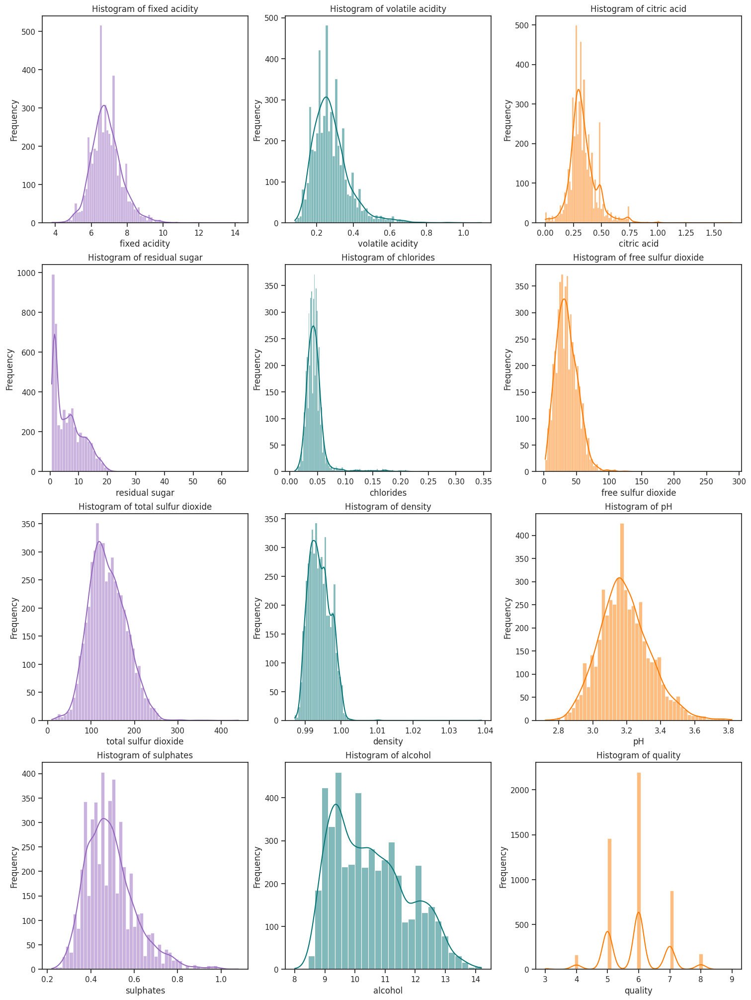

In [ ]:
combined_hist_univariate_analysis(df_w)

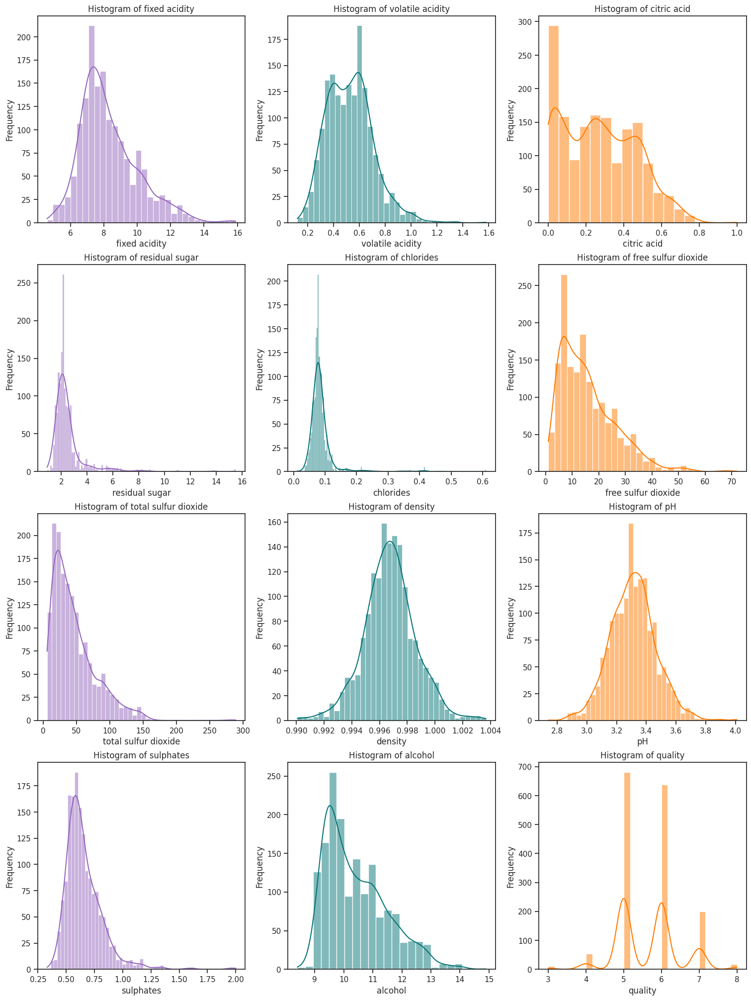

In [ ]:
combined_hist_univariate_analysis(df_r)

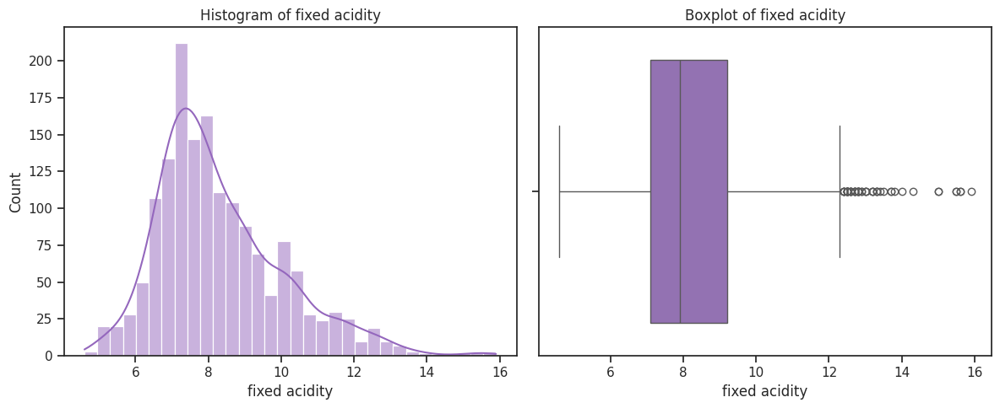

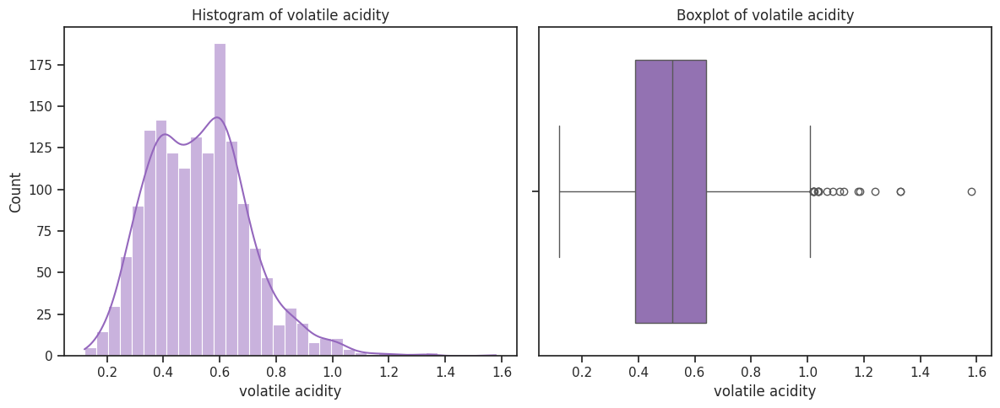

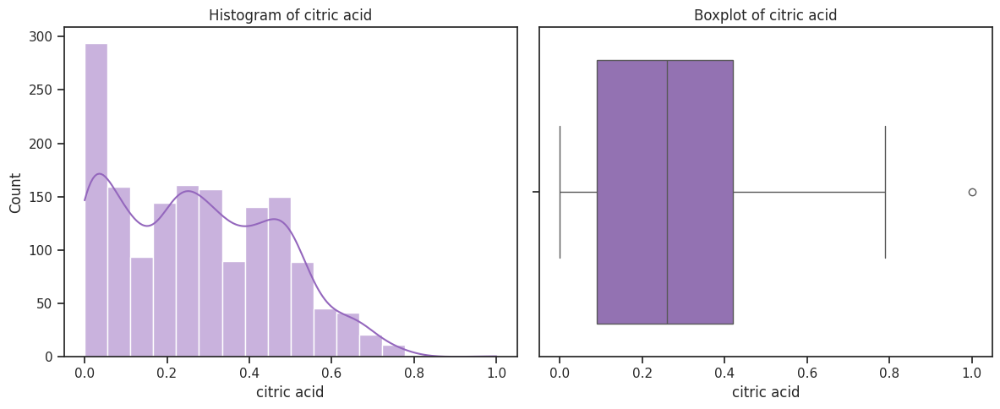

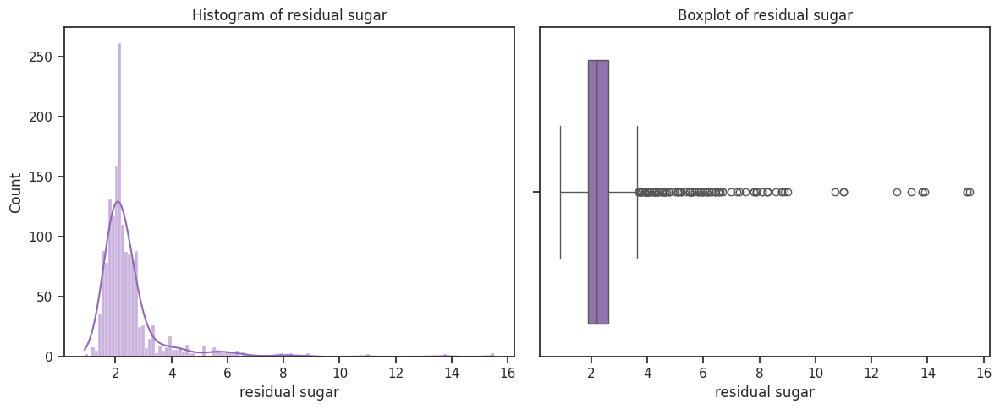

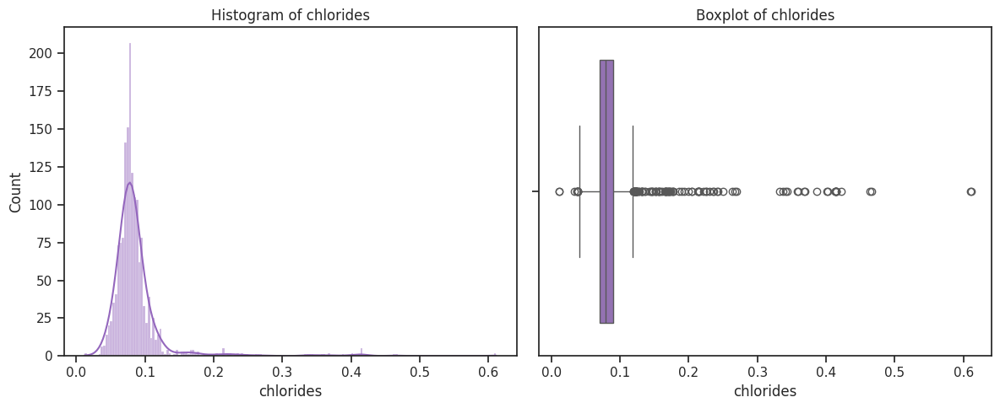

...

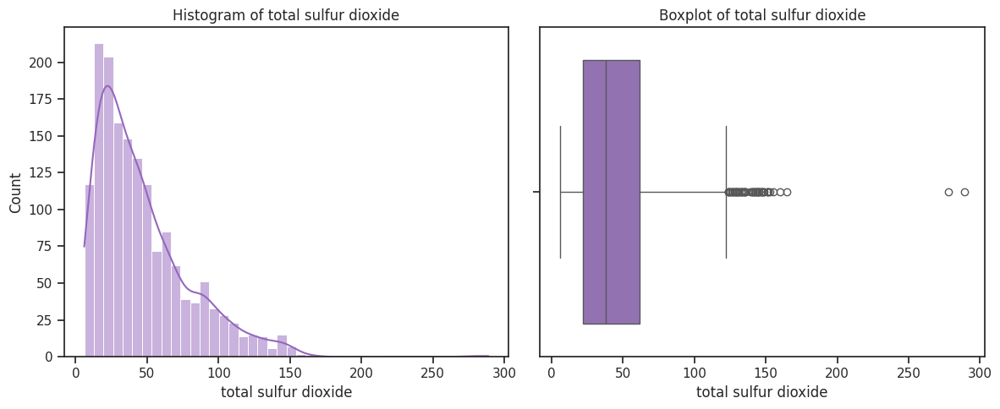

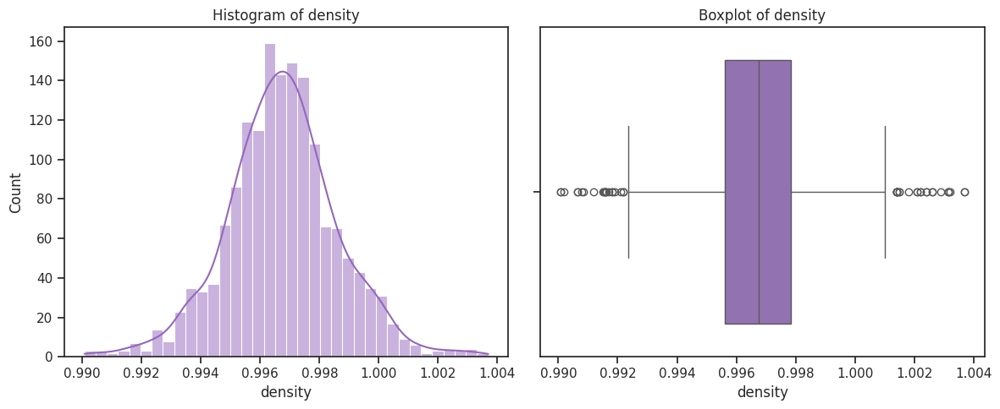

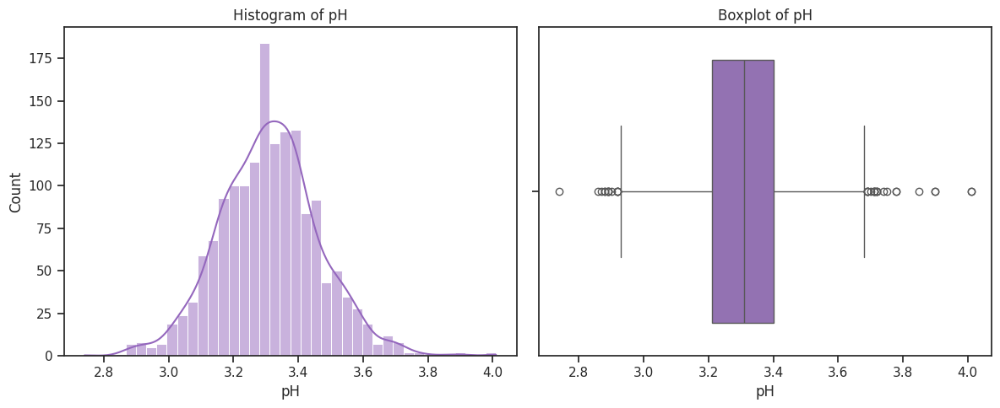

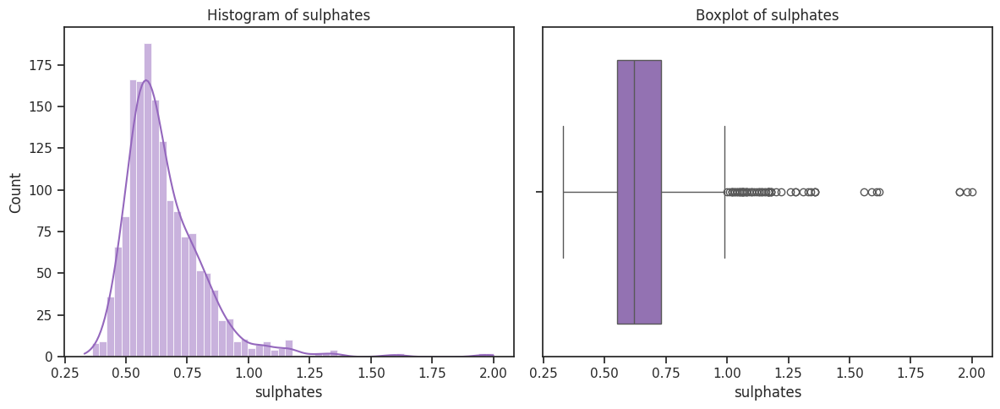

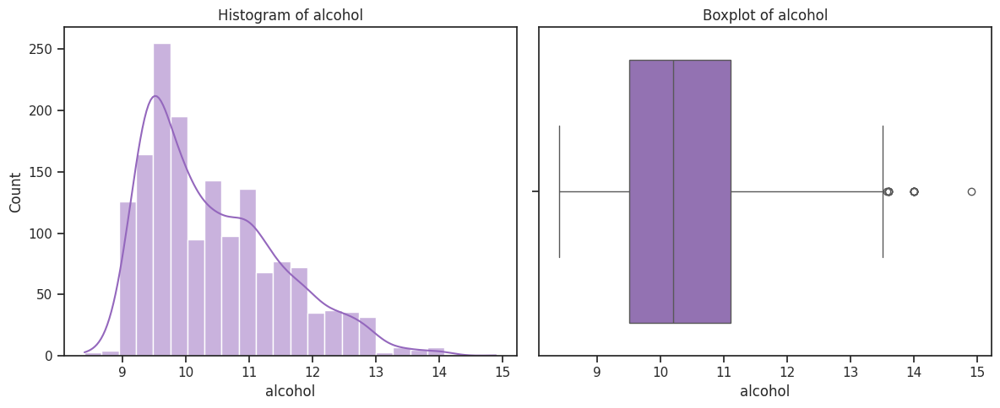

In [ ]:
univariate_analysis(df_r)

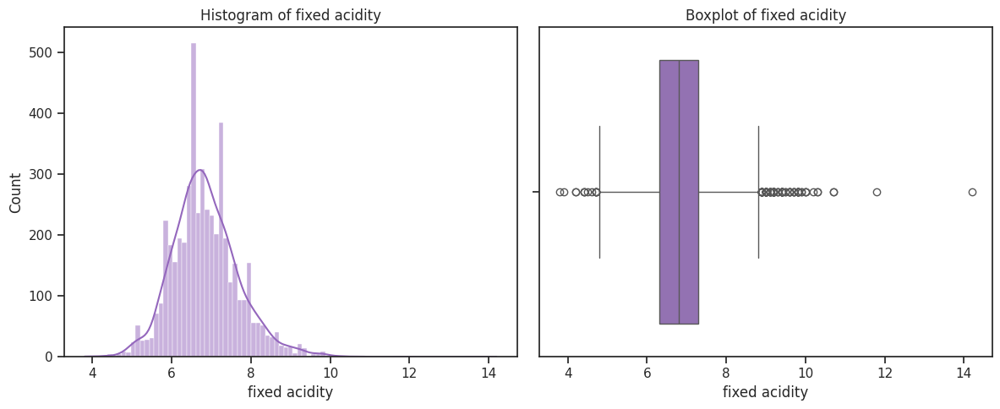

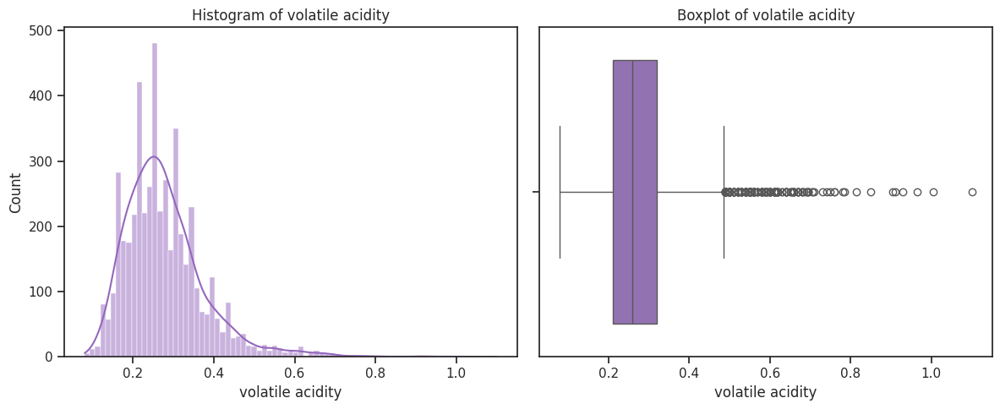

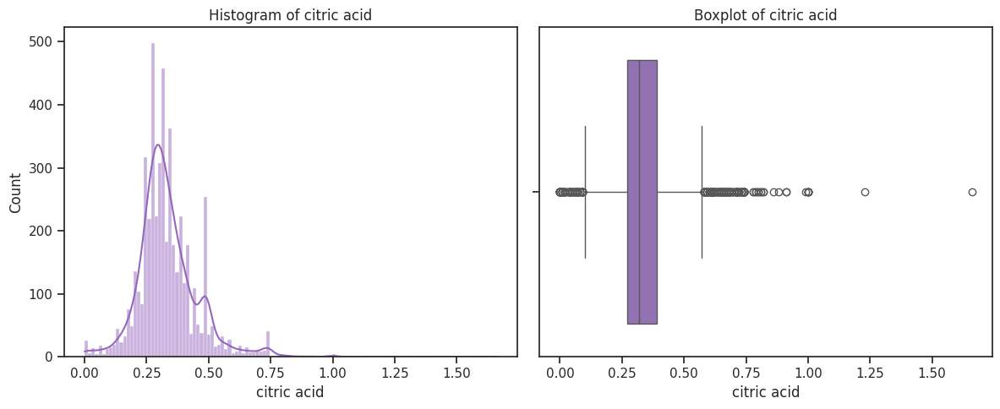

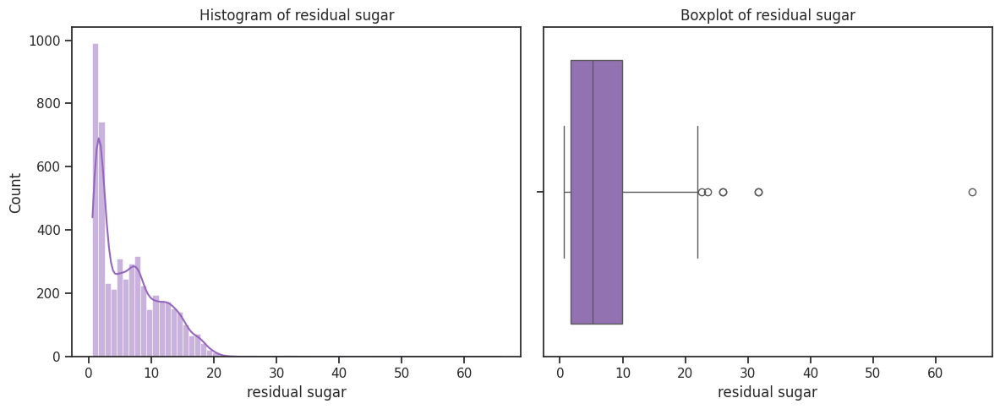

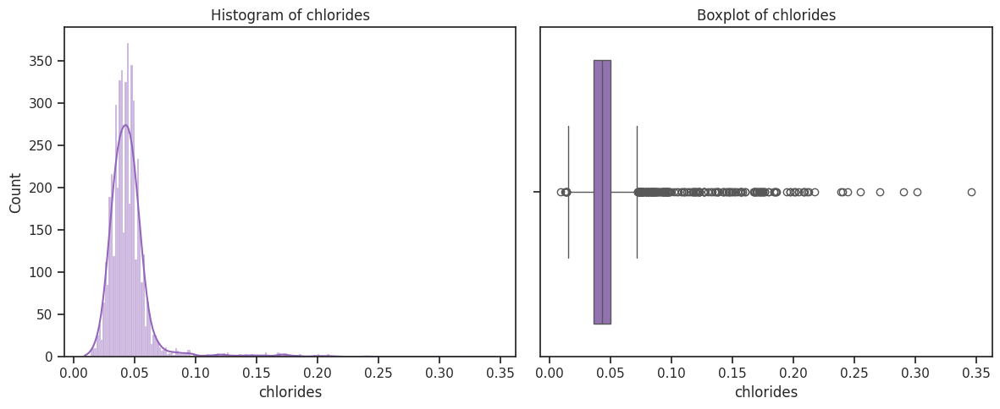

...

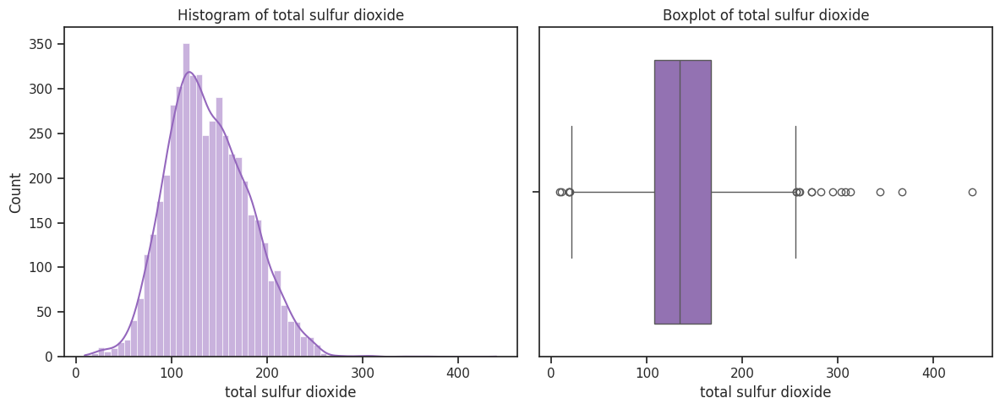

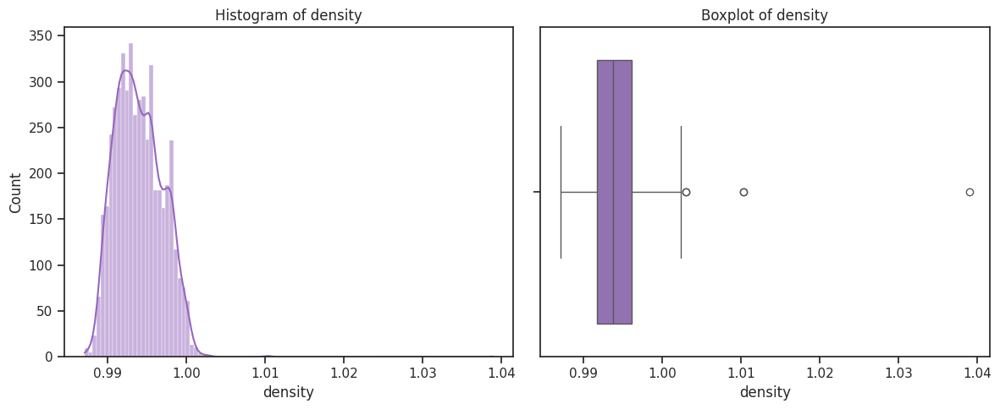

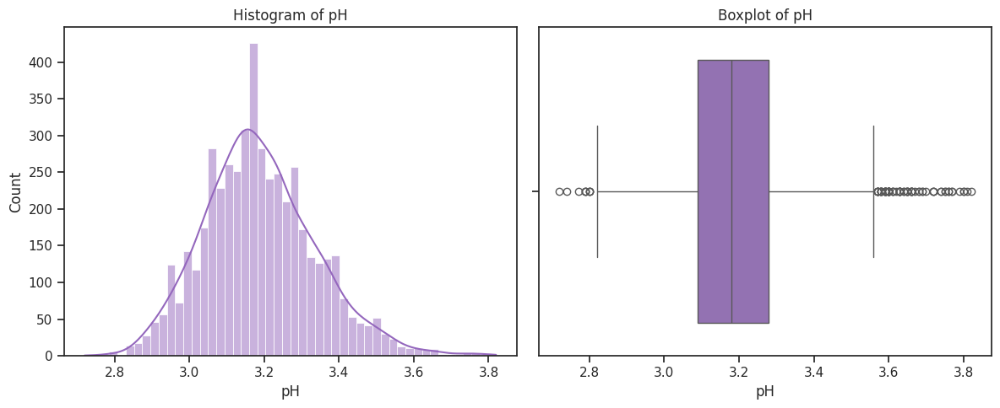

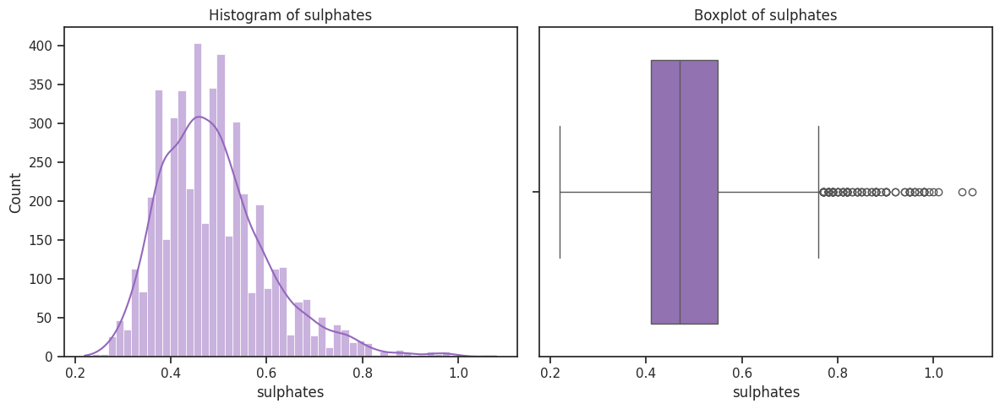

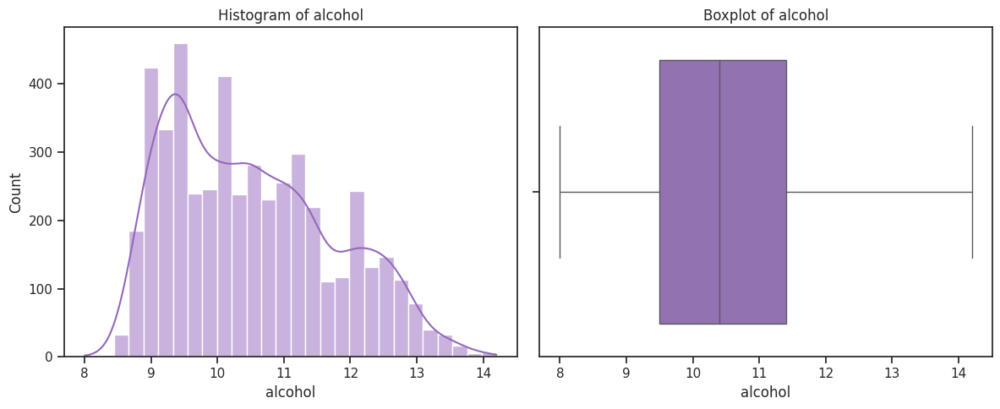

In [ ]:
univariate_analysis(df_w)

In [ ]:
calculate_univariate_statistics(df_r)


fixed acidity:
Média (µ): 8.32
Desvio Padrão (σ): 1.74
Assimetria (γ): 0.98

volatile acidity:
Média (µ): 0.53
Desvio Padrão (σ): 0.18
Assimetria (γ): 0.67

citric acid:
Média (µ): 0.27
Desvio Padrão (σ): 0.19
Assimetria (γ): 0.32

residual sugar:
Média (µ): 2.54
Desvio Padrão (σ): 1.41
Assimetria (γ): 4.54

chlorides:
Média (µ): 0.09
Desvio Padrão (σ): 0.05
Assimetria (γ): 5.68

free sulfur dioxide:
Média (µ): 15.87
Desvio Padrão (σ): 10.46
Assimetria (γ): 1.25

total sulfur dioxide:
Média (µ): 46.47
Desvio Padrão (σ): 32.90
Assimetria (γ): 1.51

density:
Média (µ): 1.00
Desvio Padrão (σ): 0.00
Assimetria (γ): 0.07

pH:
Média (µ): 3.31
Desvio Padrão (σ): 0.15
Assimetria (γ): 0.19

sulphates:
Média (µ): 0.66
Desvio Padrão (σ): 0.17
Assimetria (γ): 2.43

alcohol:
Média (µ): 10.42
Desvio Padrão (σ): 1.07
Assimetria (γ): 0.86

quality:
Média (µ): 5.64
Desvio Padrão (σ): 0.81
Assimetria (γ): 0.22


In [ ]:
calculate_univariate_statistics(df_w)


fixed acidity:
Média (µ): 6.85
Desvio Padrão (σ): 0.84
Assimetria (γ): 0.65

volatile acidity:
Média (µ): 0.28
Desvio Padrão (σ): 0.10
Assimetria (γ): 1.58

citric acid:
Média (µ): 0.33
Desvio Padrão (σ): 0.12
Assimetria (γ): 1.28

residual sugar:
Média (µ): 6.39
Desvio Padrão (σ): 5.07
Assimetria (γ): 1.08

chlorides:
Média (µ): 0.05
Desvio Padrão (σ): 0.02
Assimetria (γ): 5.02

free sulfur dioxide:
Média (µ): 35.31
Desvio Padrão (σ): 17.01
Assimetria (γ): 1.41

total sulfur dioxide:
Média (µ): 138.36
Desvio Padrão (σ): 42.50
Assimetria (γ): 0.39

density:
Média (µ): 0.99
Desvio Padrão (σ): 0.00
Assimetria (γ): 0.98

pH:
Média (µ): 3.19
Desvio Padrão (σ): 0.15
Assimetria (γ): 0.46

sulphates:
Média (µ): 0.49
Desvio Padrão (σ): 0.11
Assimetria (γ): 0.98

alcohol:
Média (µ): 10.51
Desvio Padrão (σ): 1.23
Assimetria (γ): 0.49

quality:
Média (µ): 5.88
Desvio Padrão (σ): 0.89
Assimetria (γ): 0.16


# **Item 3**
Class-conditional mono-variate analysis of each of the predictors. Class-conditional mean µ, standard deviation σ and skewness γ, with d = 1, . . . , D, using all the N observations

In [ ]:
def conditional_univariate_analysis(data, class_column):

    output_dir = 'figures'

    for column in data.columns:

        if column == class_column:
            continue

        plt.figure(figsize=(12, 5))

        plt.subplot(1, 2, 1)
        sns.histplot(data, x=column, hue=class_column, kde=True, element="step", stat="density")
        plt.title(f'Histogram of {column} by {class_column}')
        plt.xlabel(column)
        plt.ylabel('Density')

        plt.subplot(1, 2, 2)
        sns.boxplot(x=class_column, y=column, data=data)
        plt.title(f'Boxplot of {column} by {class_column}')
        plt.xlabel(class_column)
        plt.ylabel(column)

        plt.tight_layout()
        plt.savefig(f'{output_dir}/conditional_univariate_{column}_by_{class_column}.png')
        plt.show()


In [ ]:
def combined_hist_class_conditional(data, class_column):

    output_dir = 'figures'

    num_cols = 3
    num_variables = len(data.columns)
    num_rows = math.ceil(num_variables / num_cols)

    fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 5 * num_rows), constrained_layout=True)
    axes = axes.flatten()

    for i, column in enumerate(data.columns):
        sns.histplot(data[column], kde=True, ax=axes[i], color=colors[i % len(colors)])
        axes[i].set_title(f'Histogram of {column}')
        axes[i].set_xlabel(column)
        axes[i].set_ylabel('Frequency')

    for j in range(i + 1, len(axes)):
        fig.delaxes(axes[j])

    plt.savefig(f'{output_dir}/combined_hist_class_cond.png')
    plt.show()

In [ ]:
def combined_box_class_conditional(data, class_column):

    output_dir = 'figures'

    num_cols = 3
    num_variables = len(data.columns) - 1
    num_rows = math.ceil(num_variables / num_cols)

    fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 5 * num_rows), constrained_layout=True)
    axes = axes.flatten()

    index = 0

    for column in data.columns:

        if column == class_column:
            continue

        sns.boxplot(x=class_column, y=column, data=data, ax=axes[index], palette=colors, hue=class_column)
        axes[index].set_title(f'Boxplot de {column} por {class_column}')
        axes[index].set_xlabel(class_column)
        axes[index].set_ylabel(column)

        if axes[index].get_legend() is not None:
            axes[index].legend_.remove()

        index += 1

    for j in range(index, len(axes)):
        fig.delaxes(axes[j])

    plt.savefig(f'{output_dir}/combined_box_class_cond.png')
    plt.show()


In [ ]:
from scipy.stats import skew

def calculate_c_conditional(data, class_column):

    for column in data.columns:

        if column == class_column:
            continue

        for cls, group in data.groupby(class_column):

            subset = group[column]

            mean = subset.mean()
            std = subset.std()
            skewness = skew(subset)

            print(f'\n{column} | Classe {cls}:')
            print(f'Média (µ): {mean:.2f}')
            print(f'Desvio Padrão (σ): {std:.2f}')
            print(f'Assimetria (γ): {skewness:.2f}')


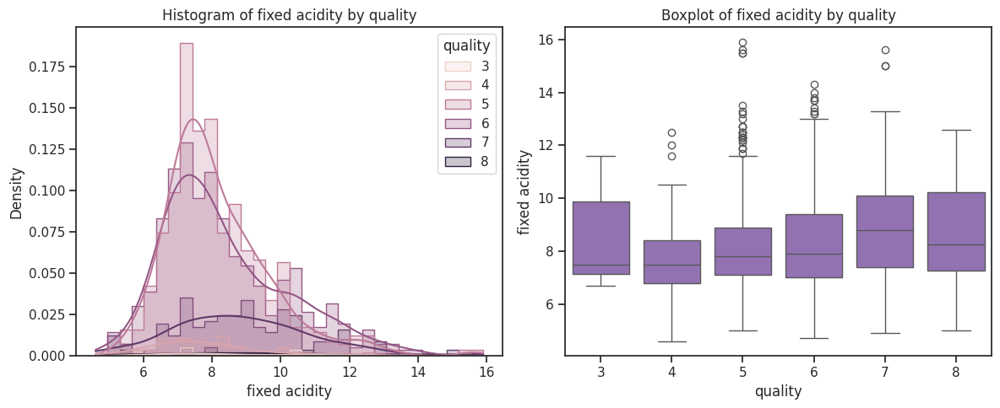

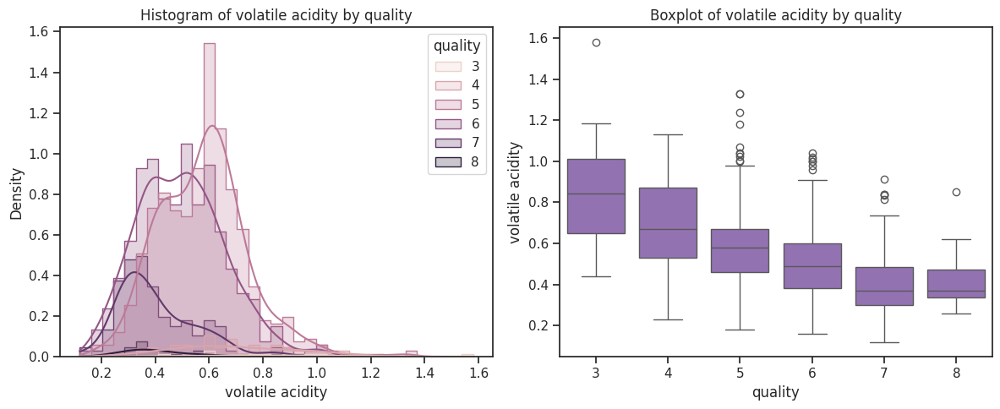

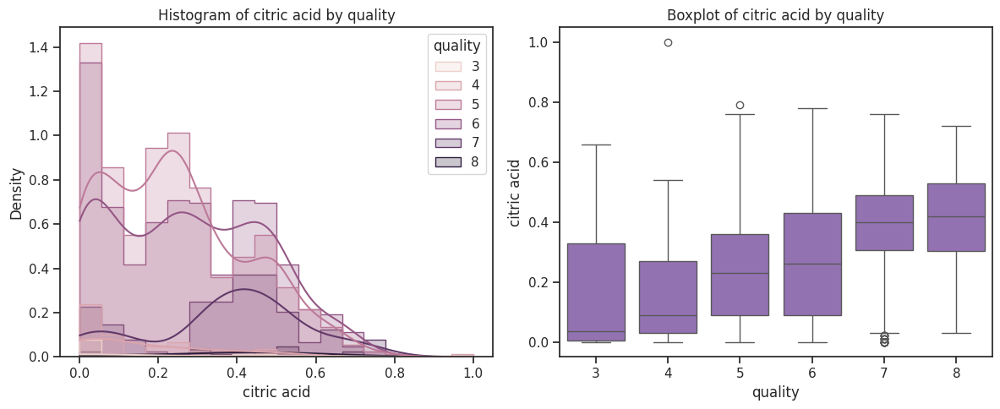

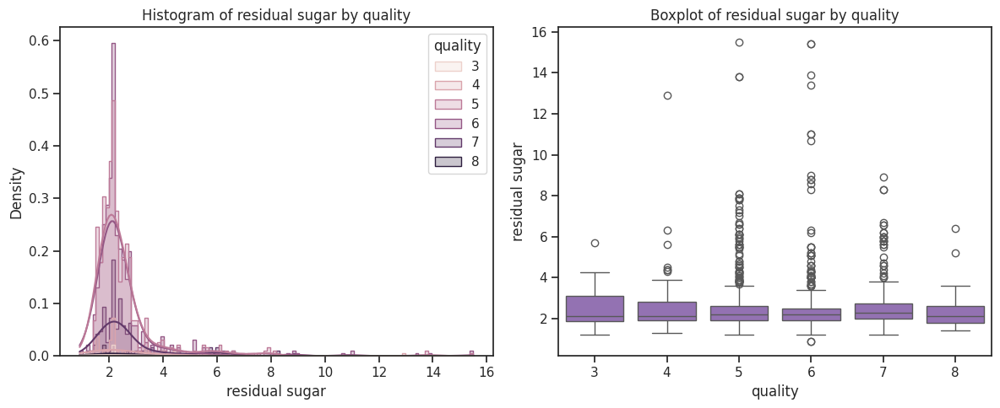

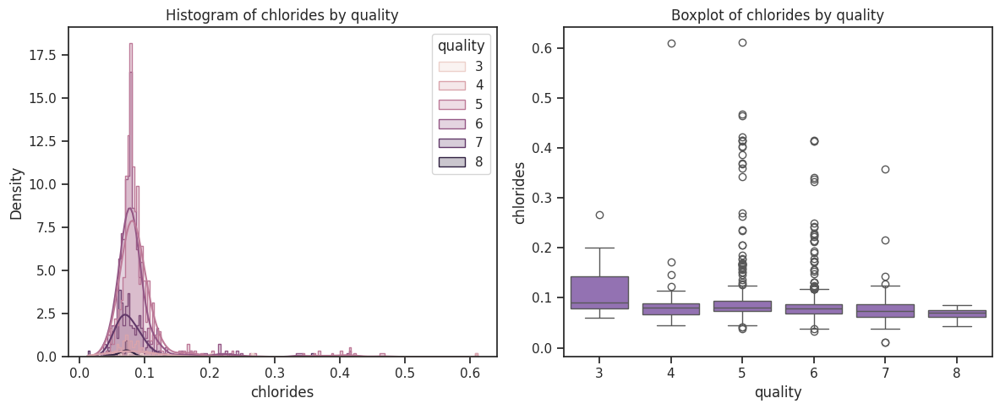

...

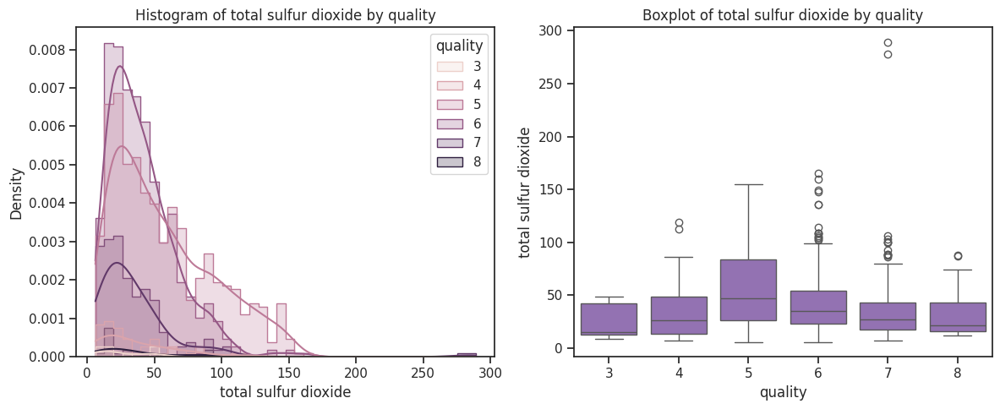

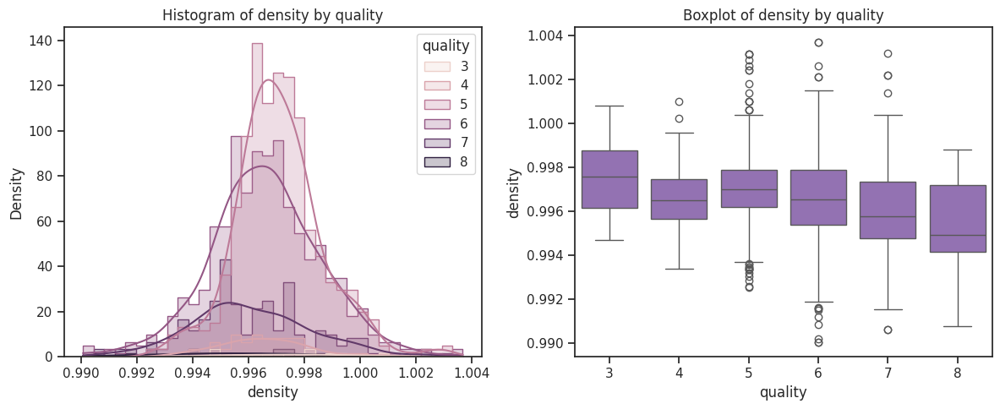

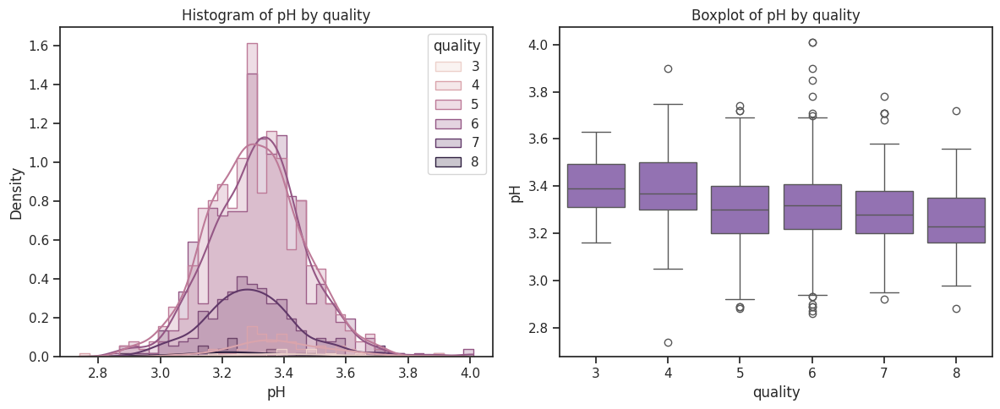

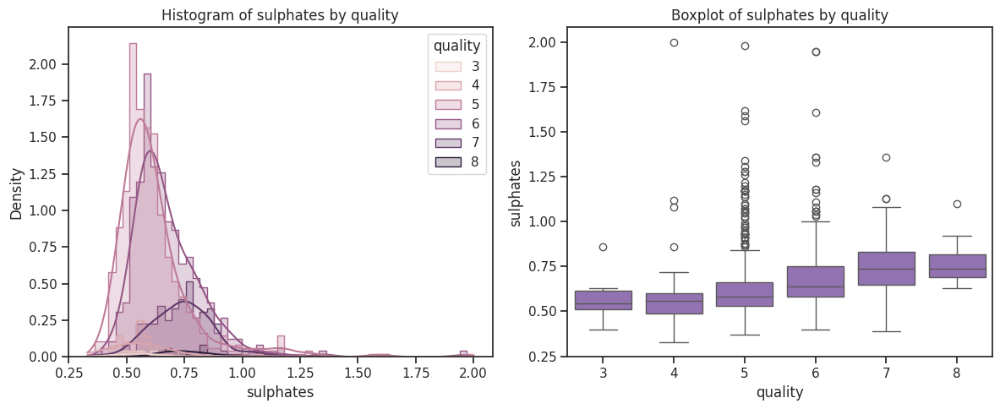

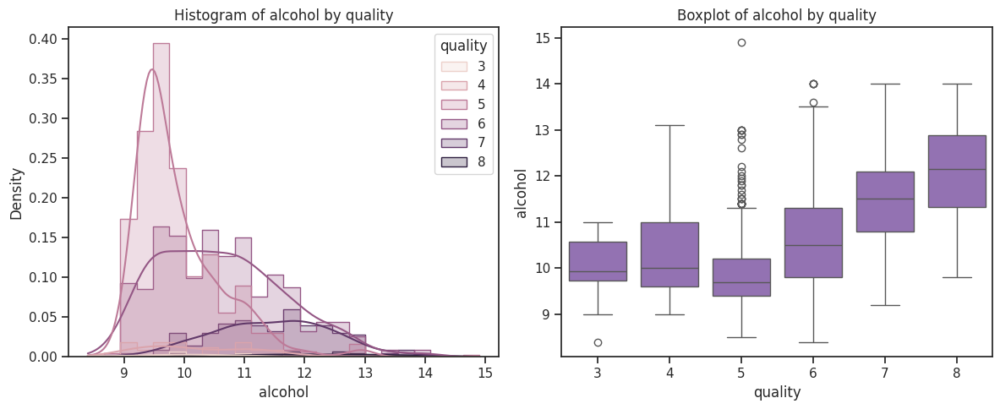

In [ ]:
conditional_univariate_analysis(df_r, 'quality')

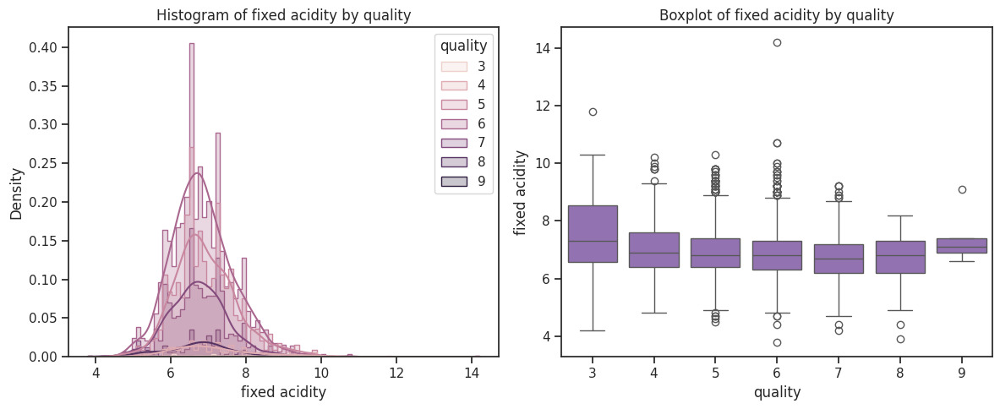

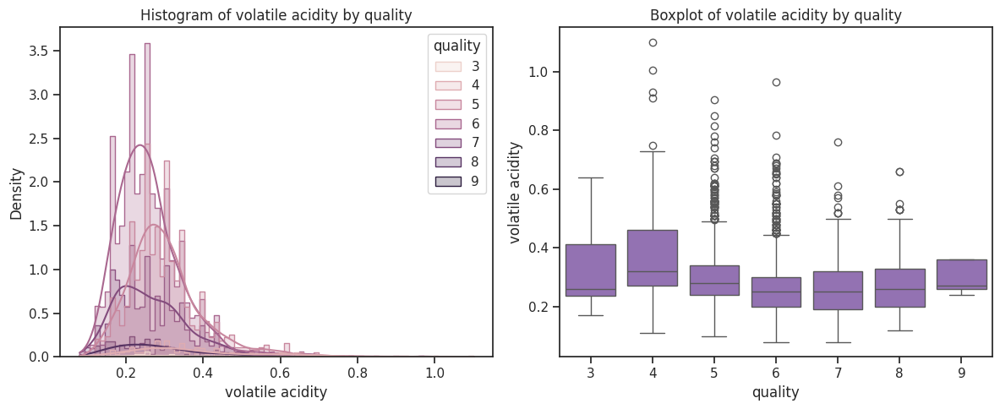

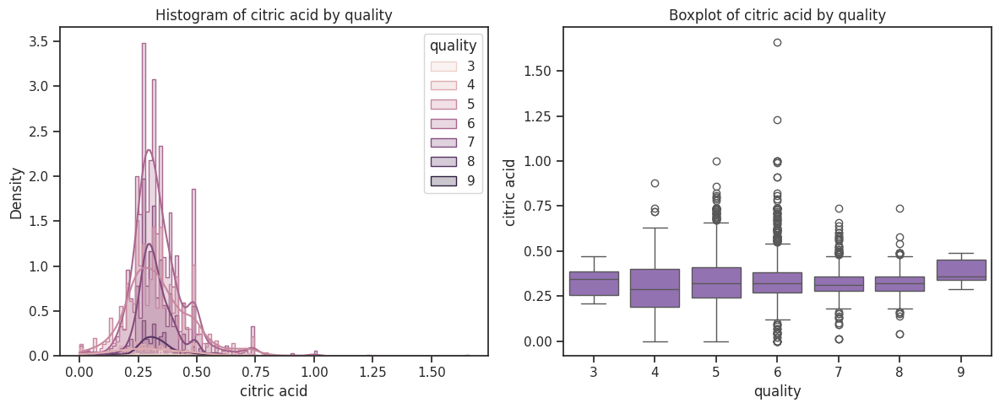

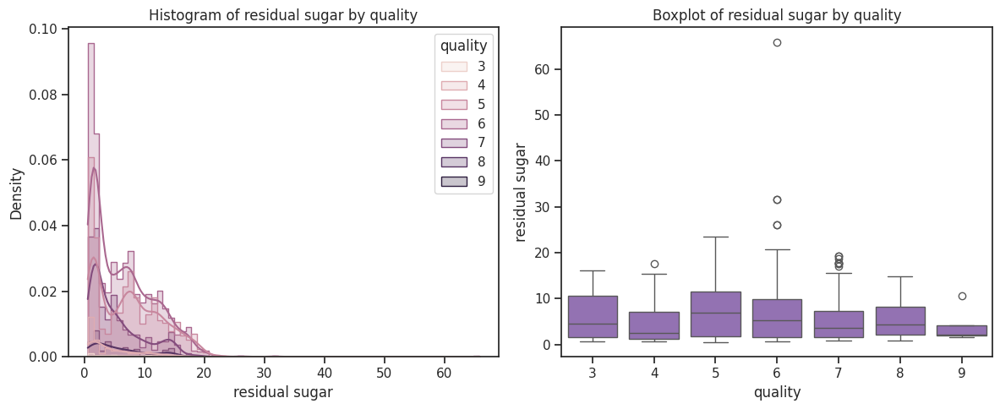

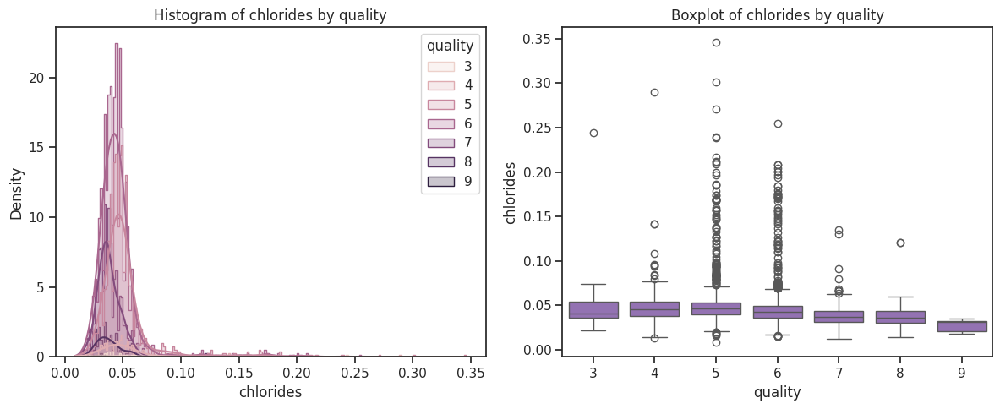

...

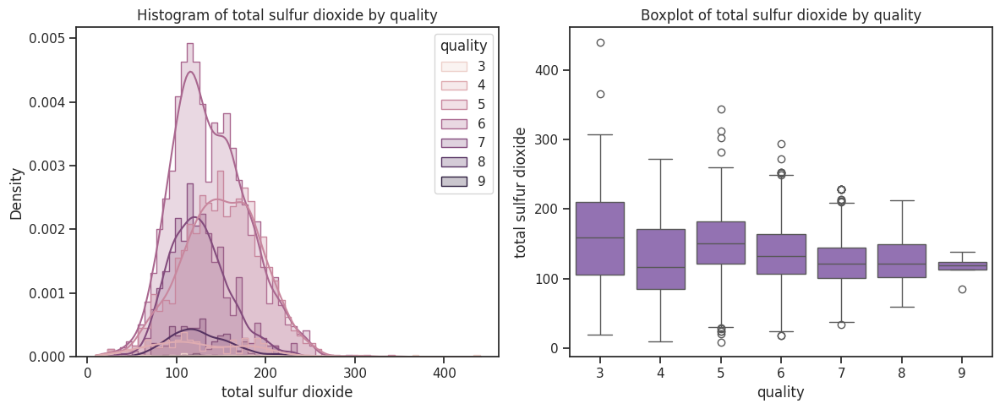

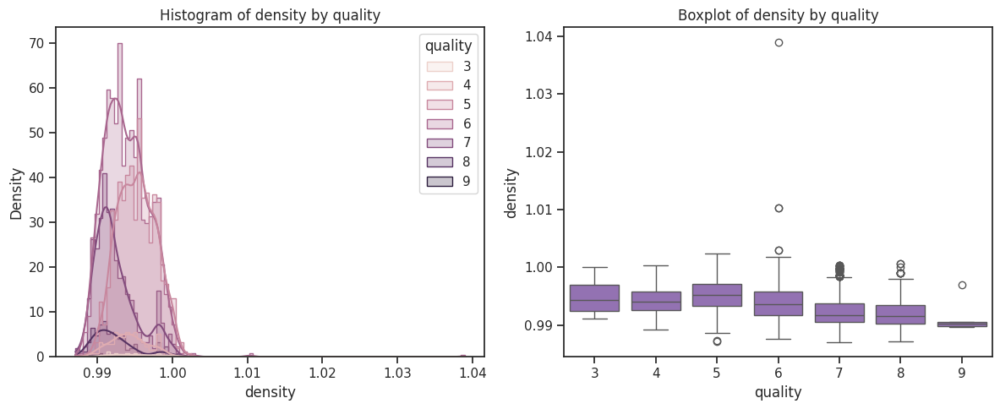

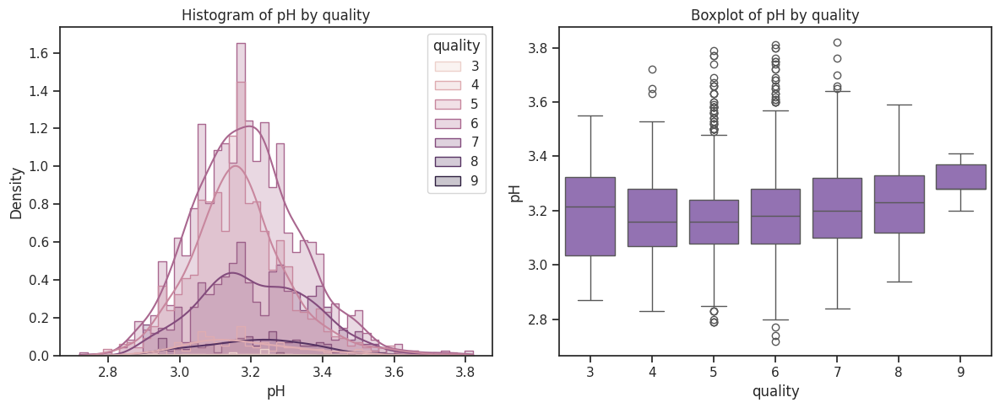

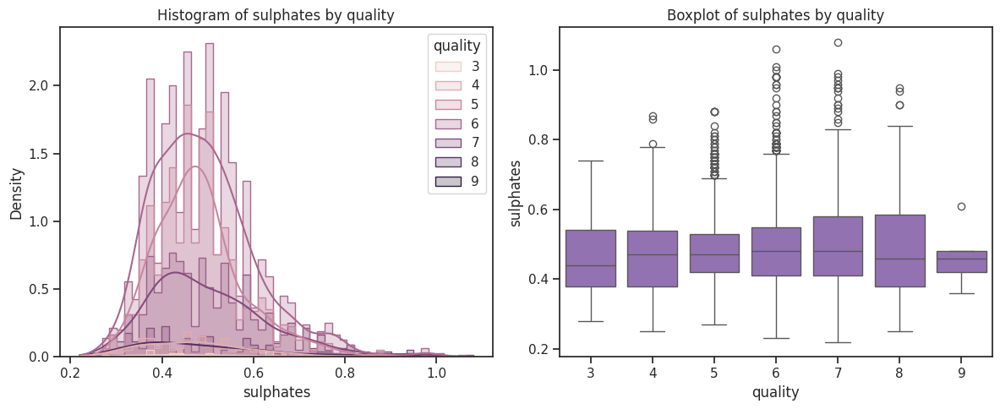

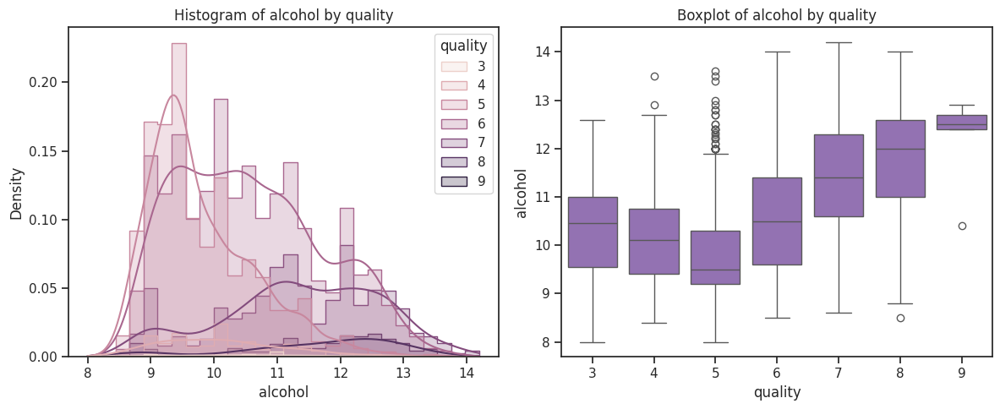

In [ ]:
conditional_univariate_analysis(df_w, 'quality')

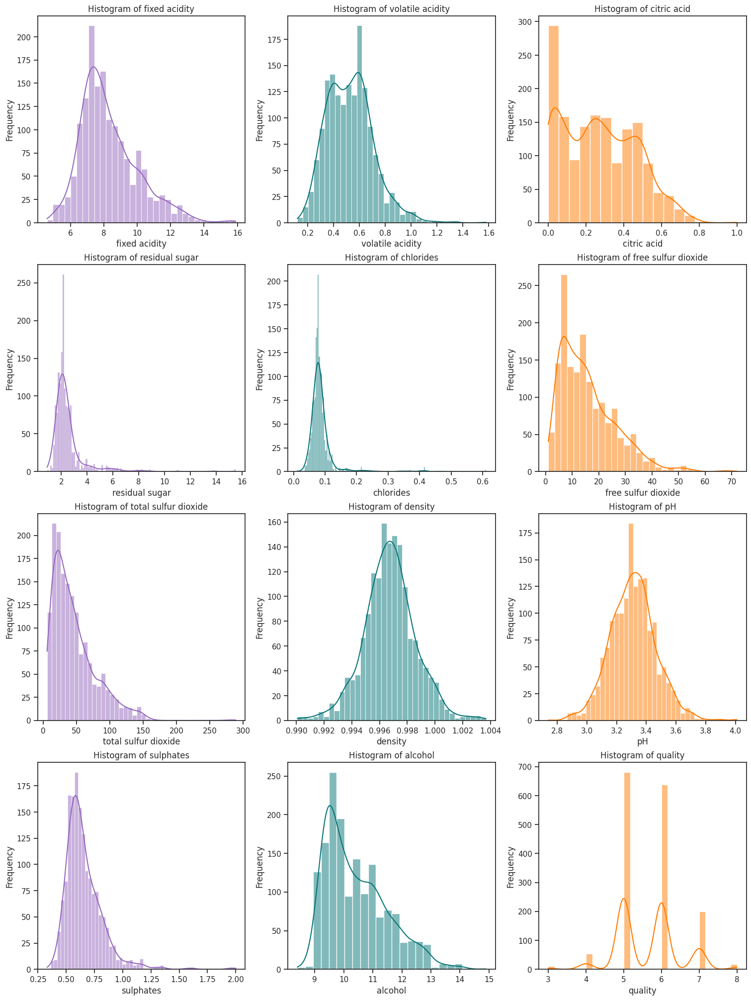

In [ ]:
combined_hist_class_conditional(df_r, 'quality')

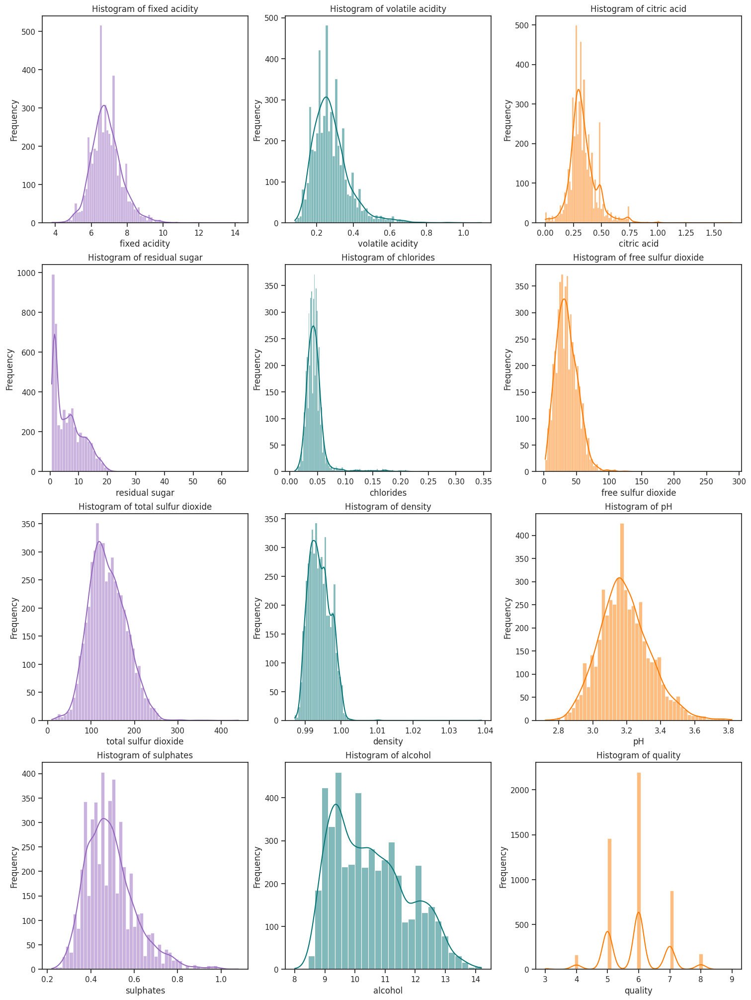

In [ ]:
combined_hist_class_conditional(df_w, 'quality')

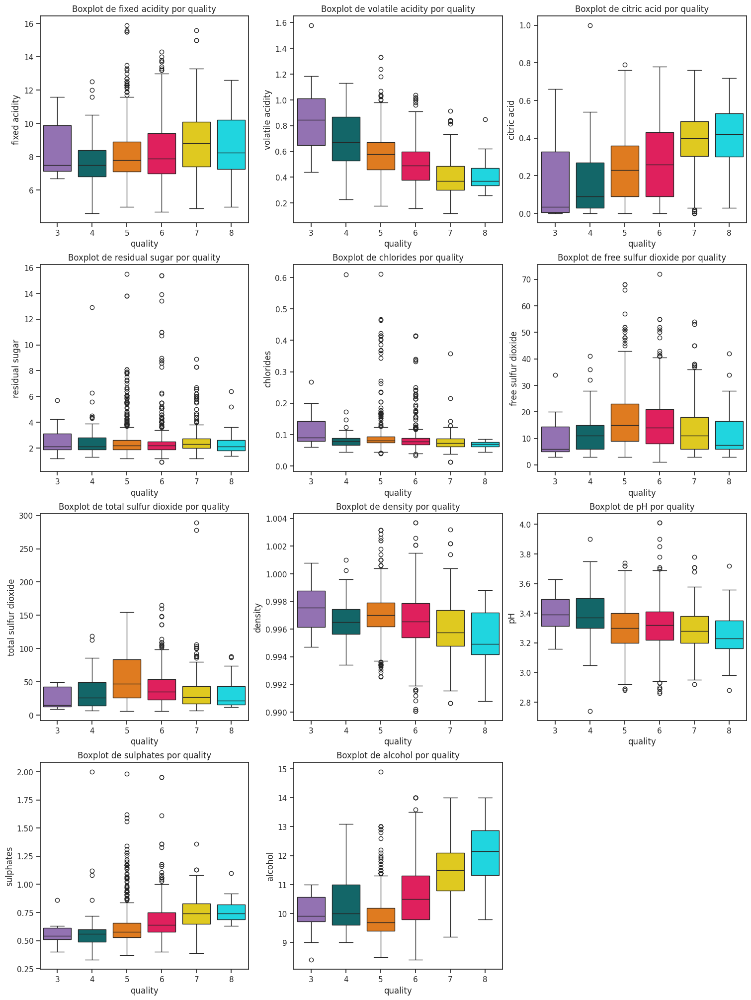

In [ ]:
combined_box_class_conditional(df_r, 'quality')

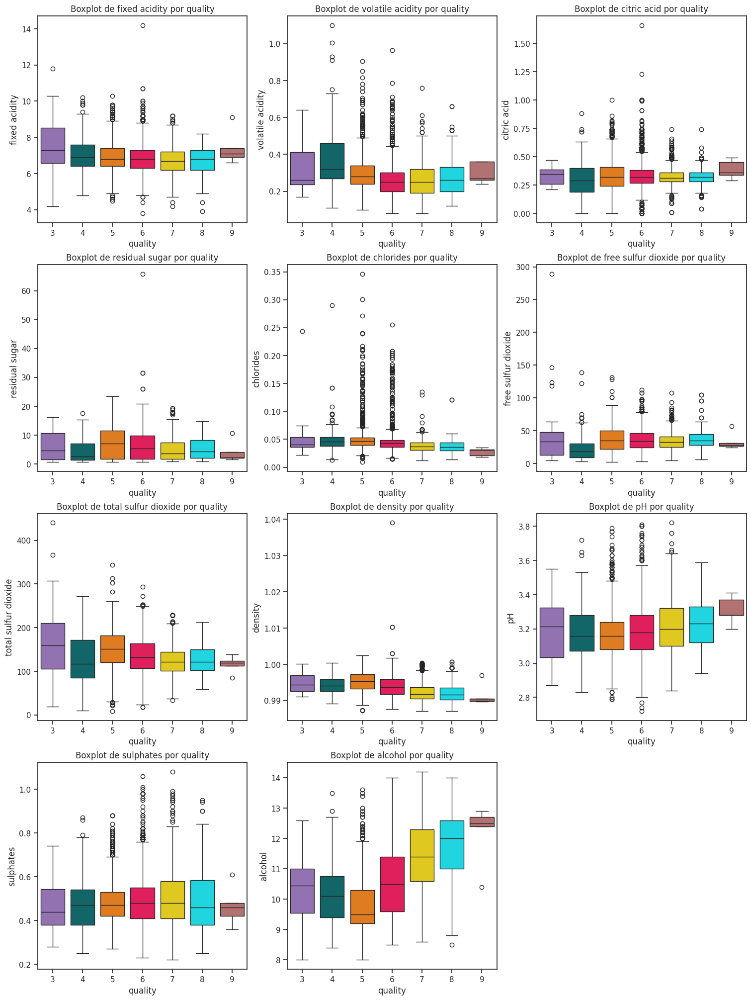

In [ ]:
combined_box_class_conditional(df_w, 'quality')

In [ ]:
calculate_c_conditional(df_r, 'quality')


fixed acidity | Classe 3:
Média (µ): 8.36
Desvio Padrão (σ): 1.77
Assimetria (γ): 0.80

fixed acidity | Classe 4:
Média (µ): 7.78
Desvio Padrão (σ): 1.63
Assimetria (γ): 0.89

fixed acidity | Classe 5:
Média (µ): 8.17
Desvio Padrão (σ): 1.56
Assimetria (γ): 1.38

fixed acidity | Classe 6:
Média (µ): 8.35
Desvio Padrão (σ): 1.80
Assimetria (γ): 0.83

fixed acidity | Classe 7:
Média (µ): 8.87
Desvio Padrão (σ): 1.99
Assimetria (γ): 0.51

fixed acidity | Classe 8:
Média (µ): 8.57
Desvio Padrão (σ): 2.12
Assimetria (γ): 0.04

volatile acidity | Classe 3:
Média (µ): 0.88
Desvio Padrão (σ): 0.33
Assimetria (γ): 0.73

volatile acidity | Classe 4:
Média (µ): 0.69
Desvio Padrão (σ): 0.22
Assimetria (γ): 0.15

volatile acidity | Classe 5:
Média (µ): 0.58
Desvio Padrão (σ): 0.16
Assimetria (γ): 0.59

volatile acidity | Classe 6:
Média (µ): 0.50
Desvio Padrão (σ): 0.16
Assimetria (γ): 0.43

volatile acidity | Classe 7:
Média (µ): 0.40
Desvio Padrão (σ): 0.15
Assimetria (γ): 0.95

volatile acidity

In [ ]:
calculate_c_conditional(df_w, 'quality')


fixed acidity | Classe 3:
Média (µ): 7.60
Desvio Padrão (σ): 1.72
Assimetria (γ): 0.51

fixed acidity | Classe 4:
Média (µ): 7.13
Desvio Padrão (σ): 1.08
Assimetria (γ): 0.77

fixed acidity | Classe 5:
Média (µ): 6.93
Desvio Padrão (σ): 0.84
Assimetria (γ): 0.60

fixed acidity | Classe 6:
Média (µ): 6.84
Desvio Padrão (σ): 0.84
Assimetria (γ): 0.75

fixed acidity | Classe 7:
Média (µ): 6.73
Desvio Padrão (σ): 0.76
Assimetria (γ): 0.14

fixed acidity | Classe 8:
Média (µ): 6.66
Desvio Padrão (σ): 0.82
Assimetria (γ): -0.51

fixed acidity | Classe 9:
Média (µ): 7.42
Desvio Padrão (σ): 0.98
Assimetria (γ): 1.18

volatile acidity | Classe 3:
Média (µ): 0.33
Desvio Padrão (σ): 0.14
Assimetria (γ): 0.95

volatile acidity | Classe 4:
Média (µ): 0.38
Desvio Padrão (σ): 0.17
Assimetria (γ): 1.39

volatile acidity | Classe 5:
Média (µ): 0.30
Desvio Padrão (σ): 0.10
Assimetria (γ): 1.43

volatile acidity | Classe 6:
Média (µ): 0.26
Desvio Padrão (σ): 0.09
Assimetria (γ): 1.53

volatile acidity |

# **Item 4**
Unconditional bi-variate analysis of the predictors

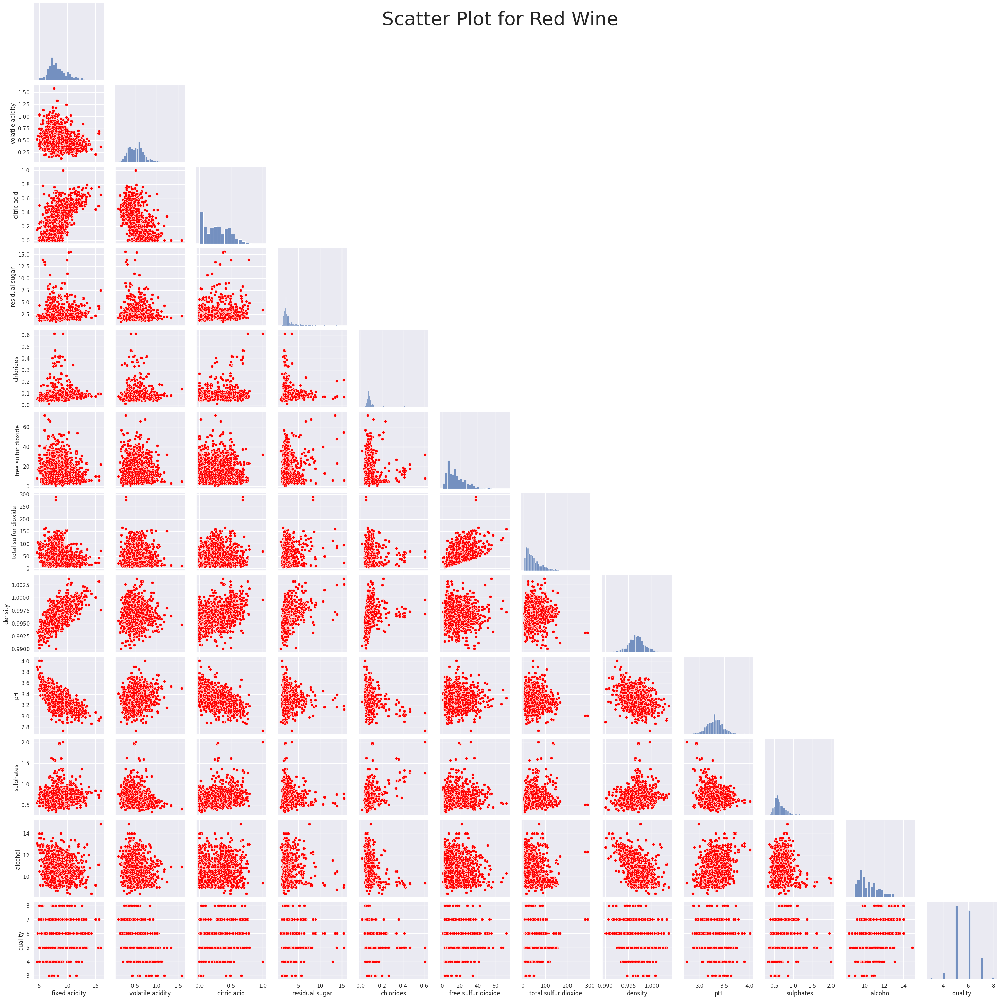

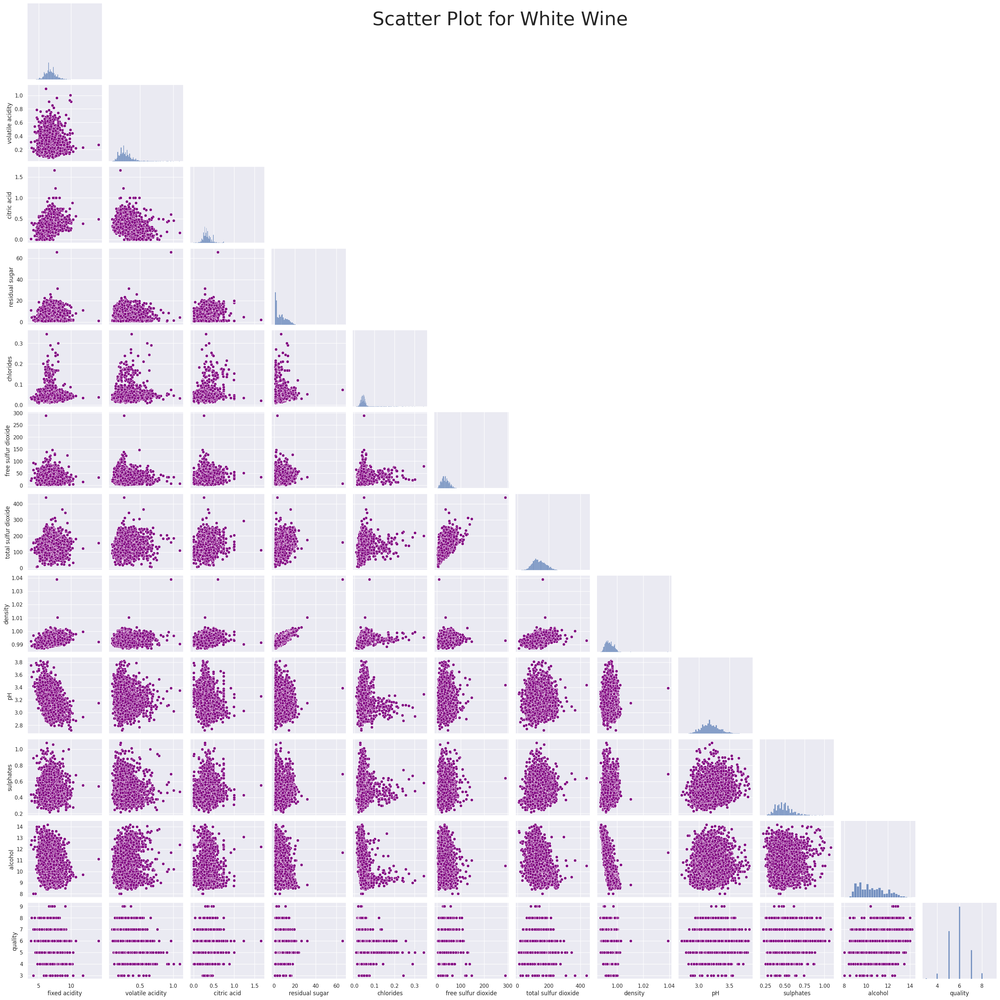

In [14]:
sns.set()

# Pairplot for the red wine dataset
pairplot_red = sns.pairplot(df_r, plot_kws={"color": "red"}, corner=True, diag_kind='hist')
pairplot_red.fig.suptitle('Scatter Plot for Red Wine', fontsize=40)

# Pairplot for the white wine dataset
pairplot_white = sns.pairplot(df_w, plot_kws={"color": "purple"}, corner=True, diag_kind='hist')
pairplot_white.fig.suptitle('Scatter Plot for White Wine', fontsize=40)

plt.show()


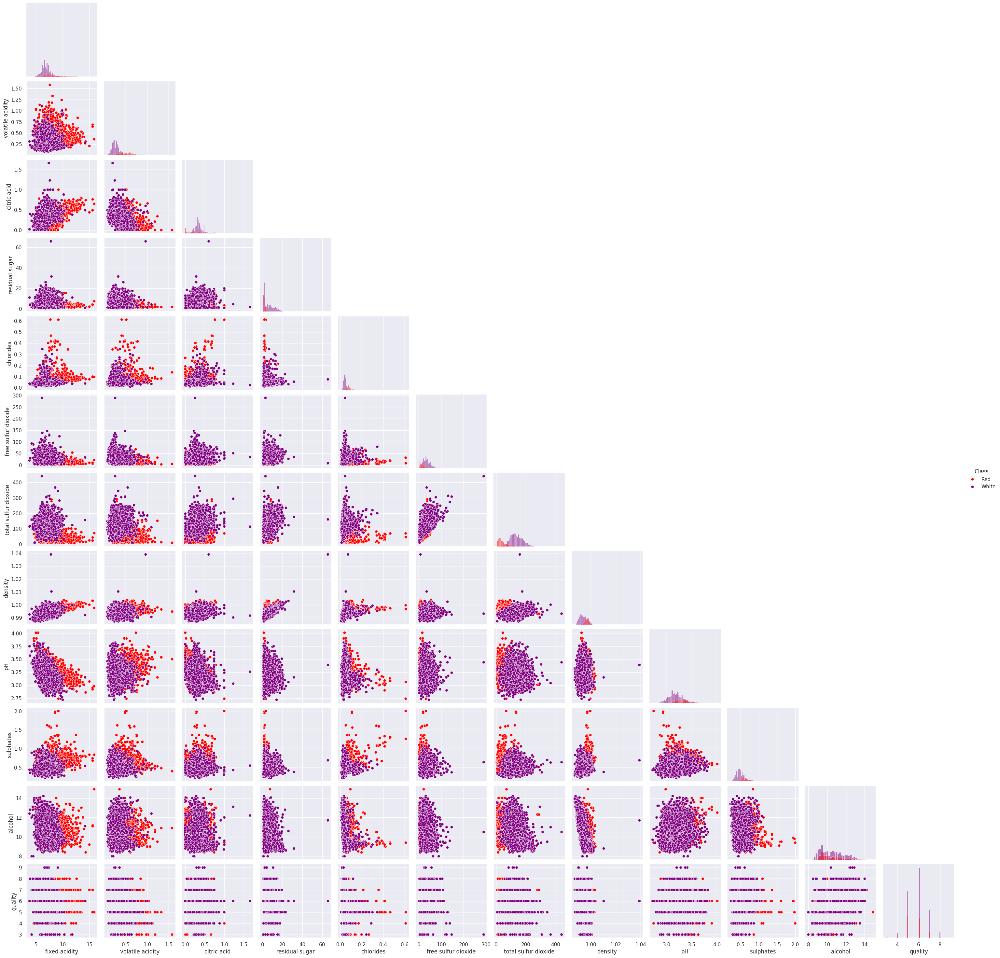

In [44]:
df_r['Class'] = 'Red'
df_w['Class'] = 'White'
combined_df = pd.concat([df_r, df_w])
sns.set()
pairplot_combined = sns.pairplot(combined_df, hue='Class', palette={'Red': 'red', 'White': 'purple'}, corner=True, diag_kind='hist')

plt.show()

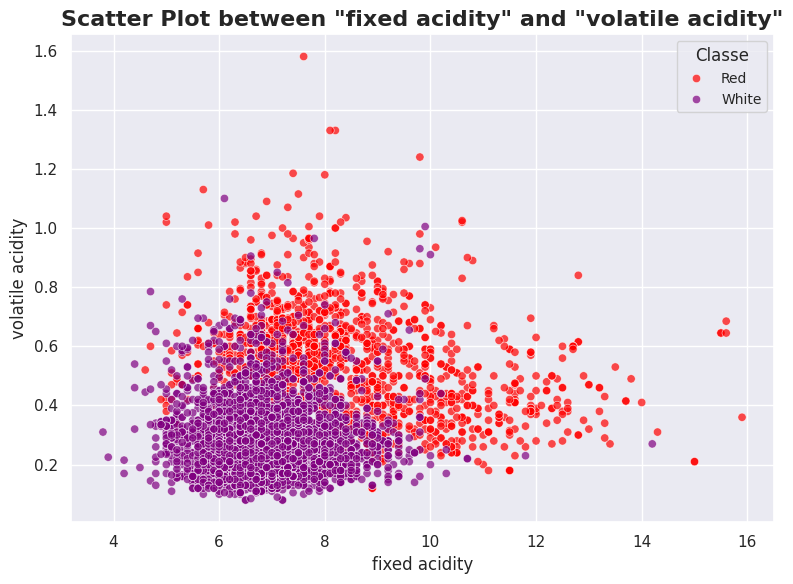

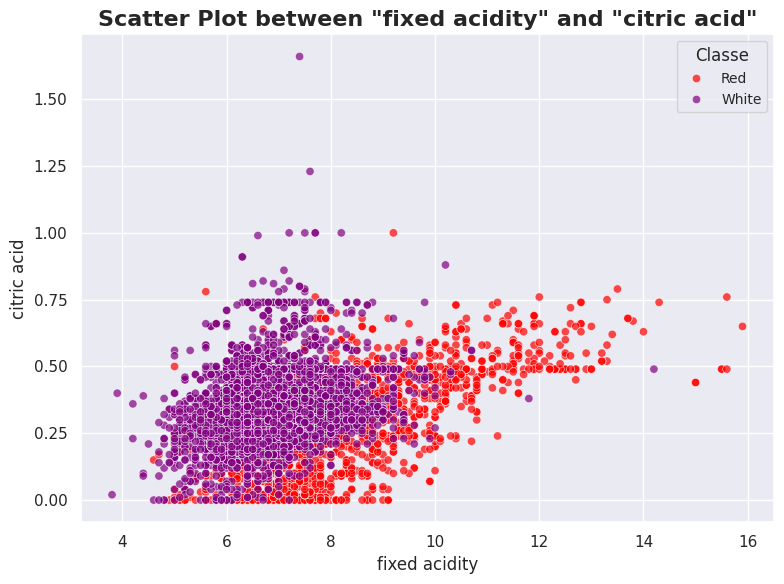

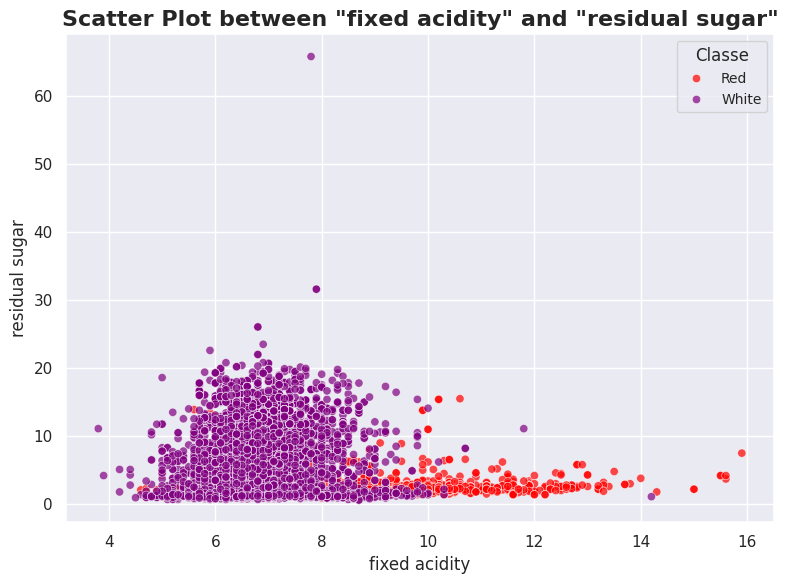

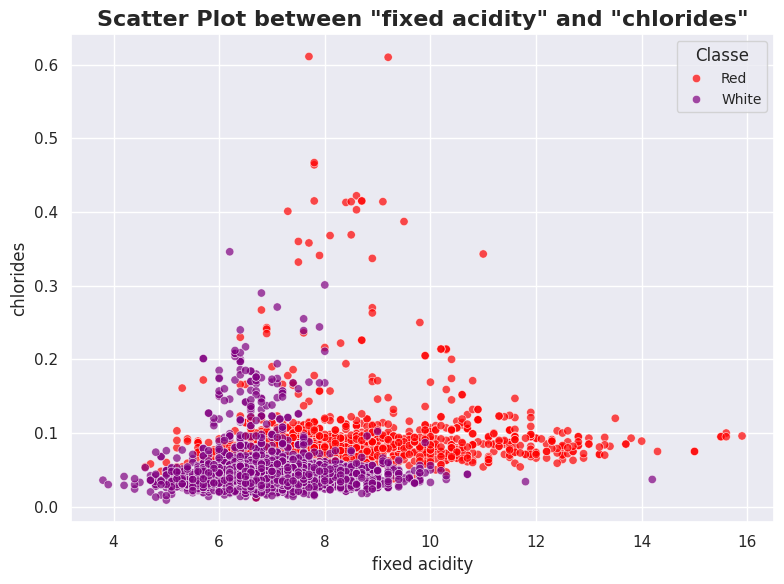

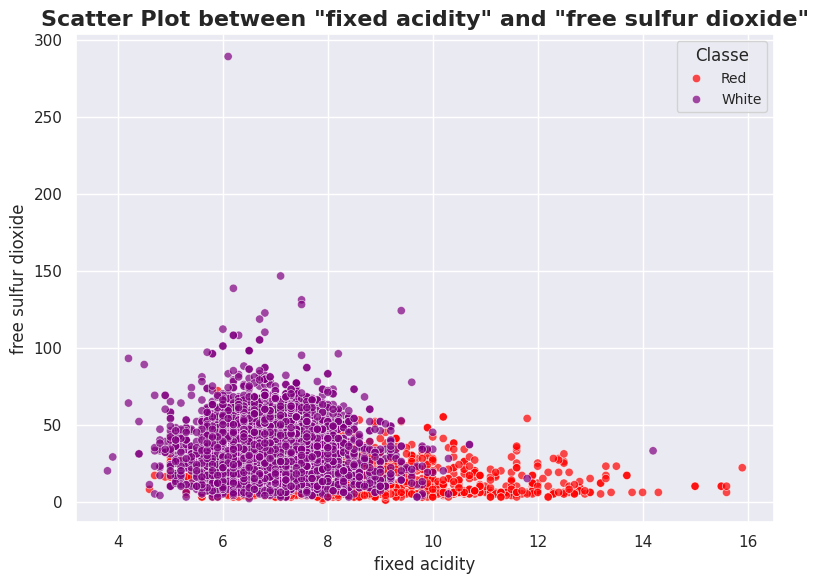

...

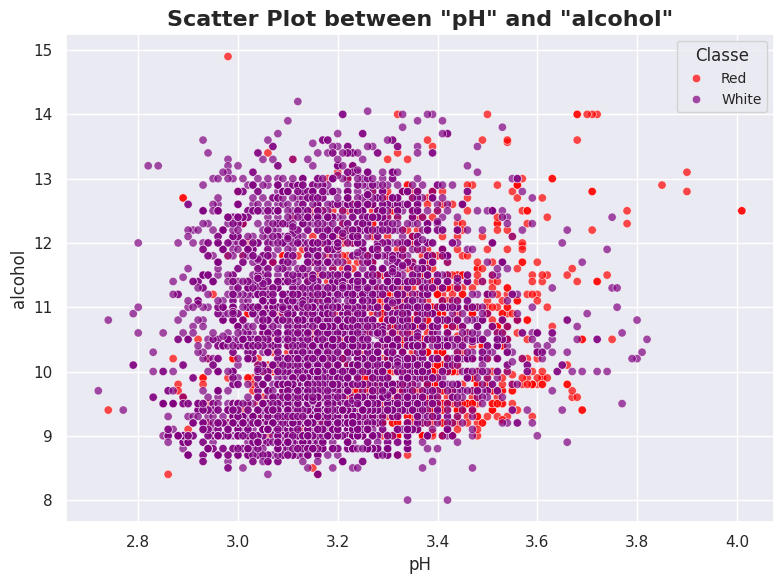

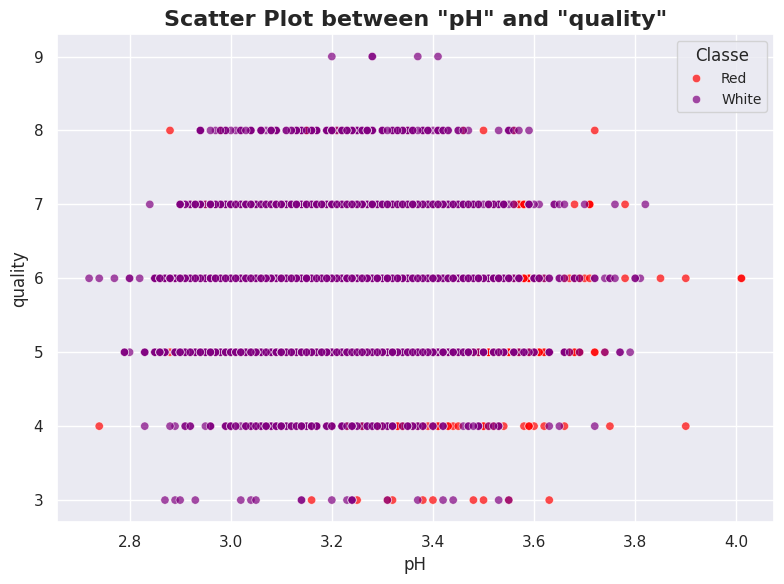

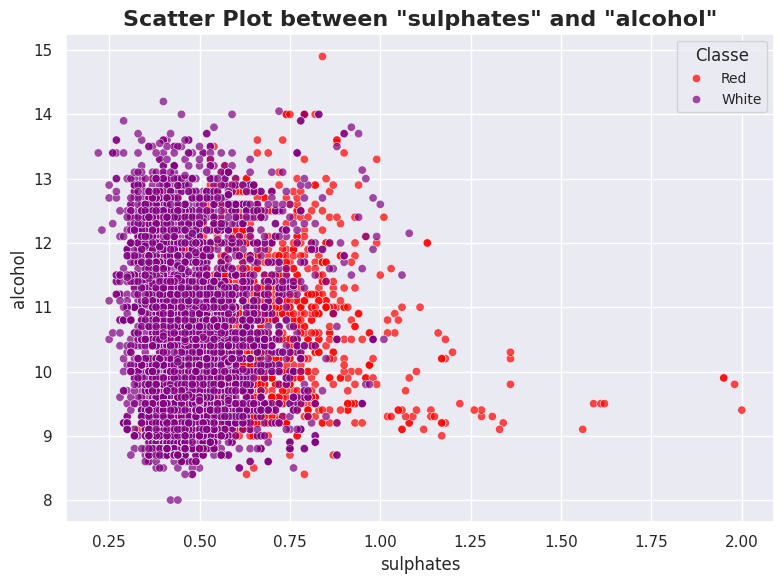

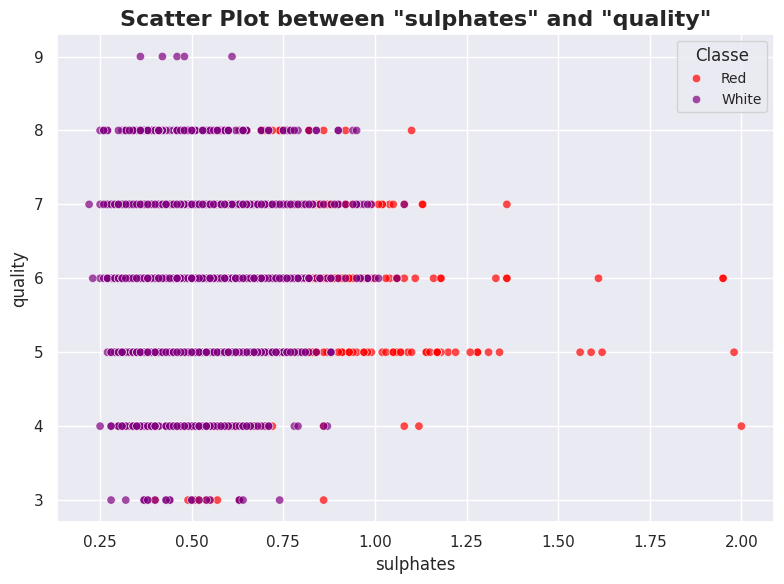

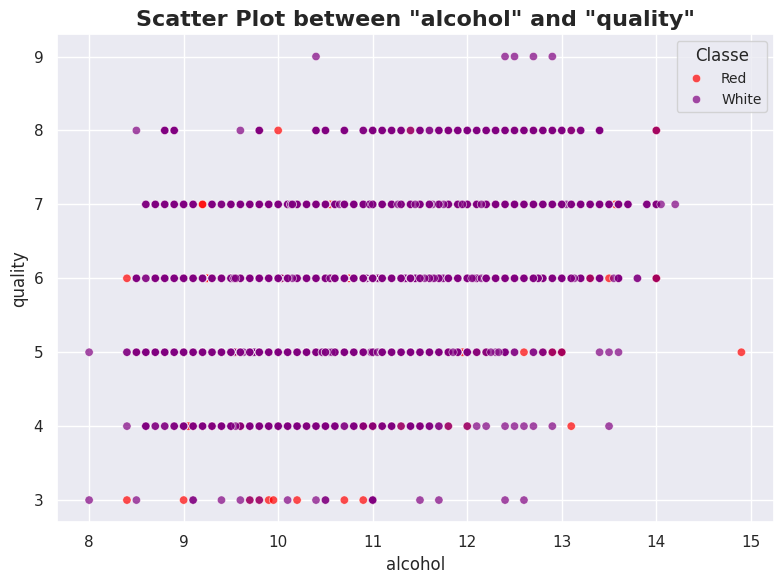

In [ ]:
predictors = combined_df.columns[:-1]

for i in range(len(predictors)):
    for j in range(i + 1, len(predictors)):
        plt.figure(figsize=(8, 6))
        sns.scatterplot(
            data=combined_df,
            x=predictors[i],
            y=predictors[j],
            hue='Class',
            palette={'Red': 'red', 'White': 'purple'},
            alpha=0.7 
        )
        plt.title(f'Scatter Plot between "{predictors[i]}" and "{predictors[j]}"', fontsize=16, weight='bold')
        plt.xlabel(predictors[i], fontsize=12)
        plt.ylabel(predictors[j], fontsize=12)
        plt.legend(title='Classe', title_fontsize=12, fontsize=10)
        plt.tight_layout()
        plt.show()


                      fixed acidity  volatile acidity  citric acid  \
fixed acidity              1.000000          0.219008     0.324436   
volatile acidity           0.219008          1.000000    -0.377981   
citric acid                0.324436         -0.377981     1.000000   
residual sugar            -0.111981         -0.196011     0.142451   
chlorides                  0.298195          0.377124     0.038998   
free sulfur dioxide       -0.282735         -0.352557     0.133126   
total sulfur dioxide      -0.329054         -0.414476     0.195242   
density                    0.458910          0.271296     0.096154   
pH                        -0.252700          0.261454    -0.329808   
sulphates                  0.299568          0.225984     0.056197   
alcohol                   -0.095452         -0.037640    -0.010493   
quality                   -0.076743         -0.265699     0.085532   

                      residual sugar  chlorides  free sulfur dioxide  \
fixed acidity    

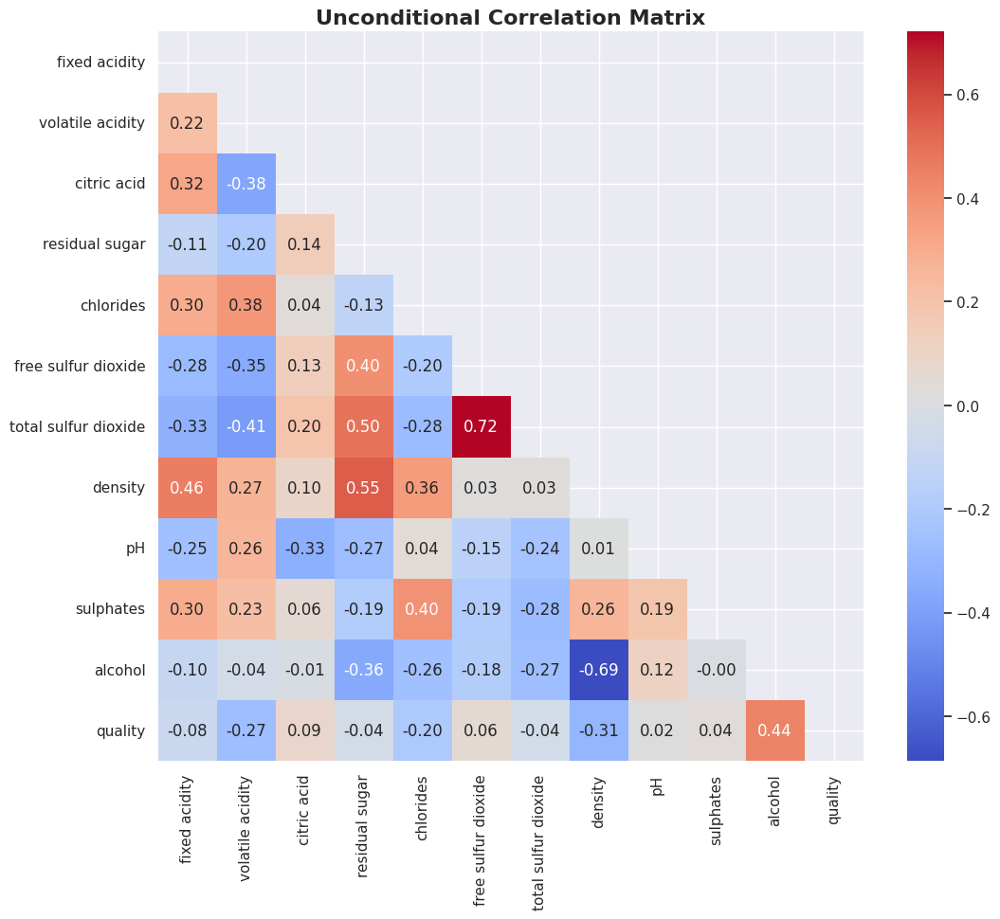

In [ ]:
## Correlation Matrix
matriz_incod = combined_df[predictors].corr()
print(matriz_incod)

mask = np.triu(np.ones_like(matriz_incod, dtype=bool))

plt.figure(figsize=(12, 10))
sns.heatmap(matriz_incod, mask=mask, annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Unconditional Correlation Matrix', fontsize=16, weight='bold')
plt.show()


                      fixed acidity  volatile acidity  citric acid  \
fixed acidity              1.000000         -0.256131     0.671703   
volatile acidity          -0.256131          1.000000    -0.552496   
citric acid                0.671703         -0.552496     1.000000   
residual sugar             0.114777          0.001918     0.143577   
chlorides                  0.093705          0.061298     0.203823   
free sulfur dioxide       -0.153794         -0.010504    -0.060978   
total sulfur dioxide      -0.113181          0.076470     0.035533   
density                    0.668047          0.022026     0.364947   
pH                        -0.682978          0.234937    -0.541904   
sulphates                  0.183006         -0.260987     0.312770   
alcohol                   -0.061668         -0.202288     0.109903   
quality                    0.124052         -0.390558     0.226373   

                      residual sugar  chlorides  free sulfur dioxide  \
fixed acidity    

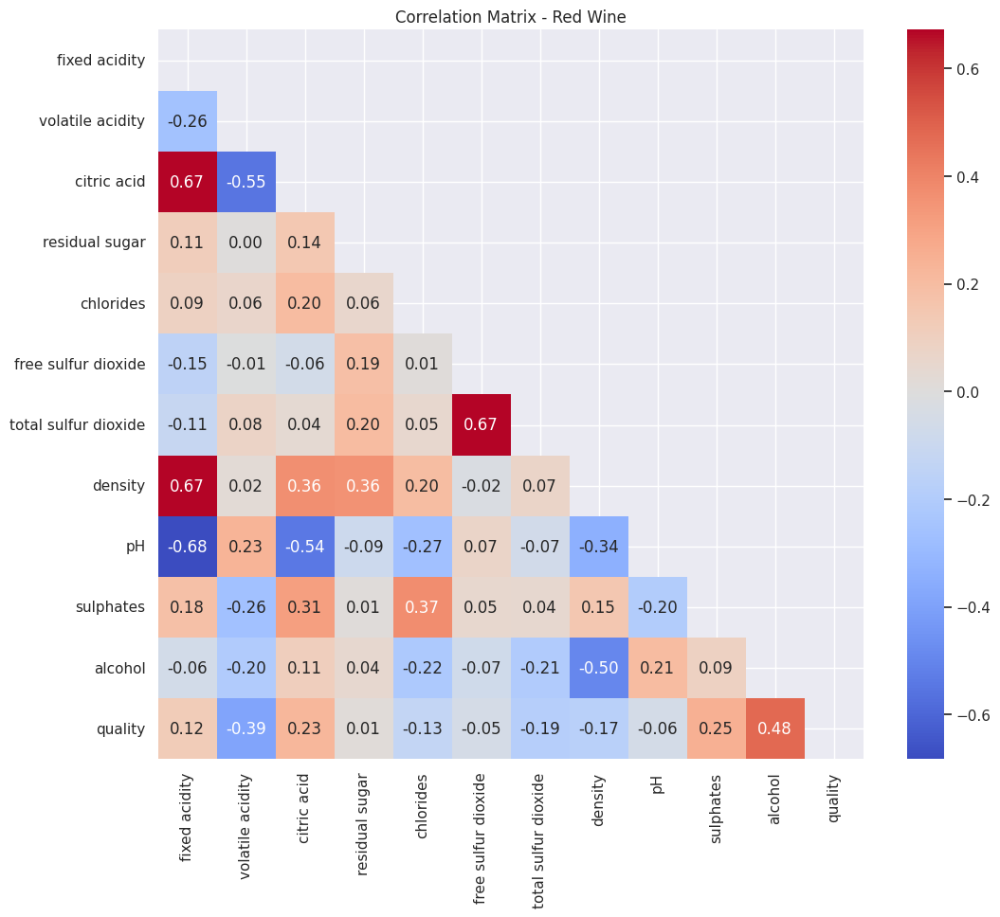

In [ ]:
## Correlation Matrix - Red Wine
red_matriz = df_r.drop(columns=["Class"]).corr()
print(red_matriz)

mask = np.triu(np.ones(red_matriz.shape, dtype=bool))

plt.figure(figsize=(12, 10))
sns.heatmap(red_matriz, mask=mask, annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Correlation Matrix - Red Wine')

plt.show()


                      fixed acidity  volatile acidity  citric acid  \
fixed acidity              1.000000         -0.022697     0.289181   
volatile acidity          -0.022697          1.000000    -0.149472   
citric acid                0.289181         -0.149472     1.000000   
residual sugar             0.089021          0.064286     0.094212   
chlorides                  0.023086          0.070512     0.114364   
free sulfur dioxide       -0.049396         -0.097012     0.094077   
total sulfur dioxide       0.091070          0.089261     0.121131   
density                    0.265331          0.027114     0.149503   
pH                        -0.425858         -0.031915    -0.163748   
sulphates                 -0.017143         -0.035728     0.062331   
alcohol                   -0.120881          0.067718    -0.075729   
quality                   -0.113663         -0.194723    -0.009209   

                      residual sugar  chlorides  free sulfur dioxide  \
fixed acidity    

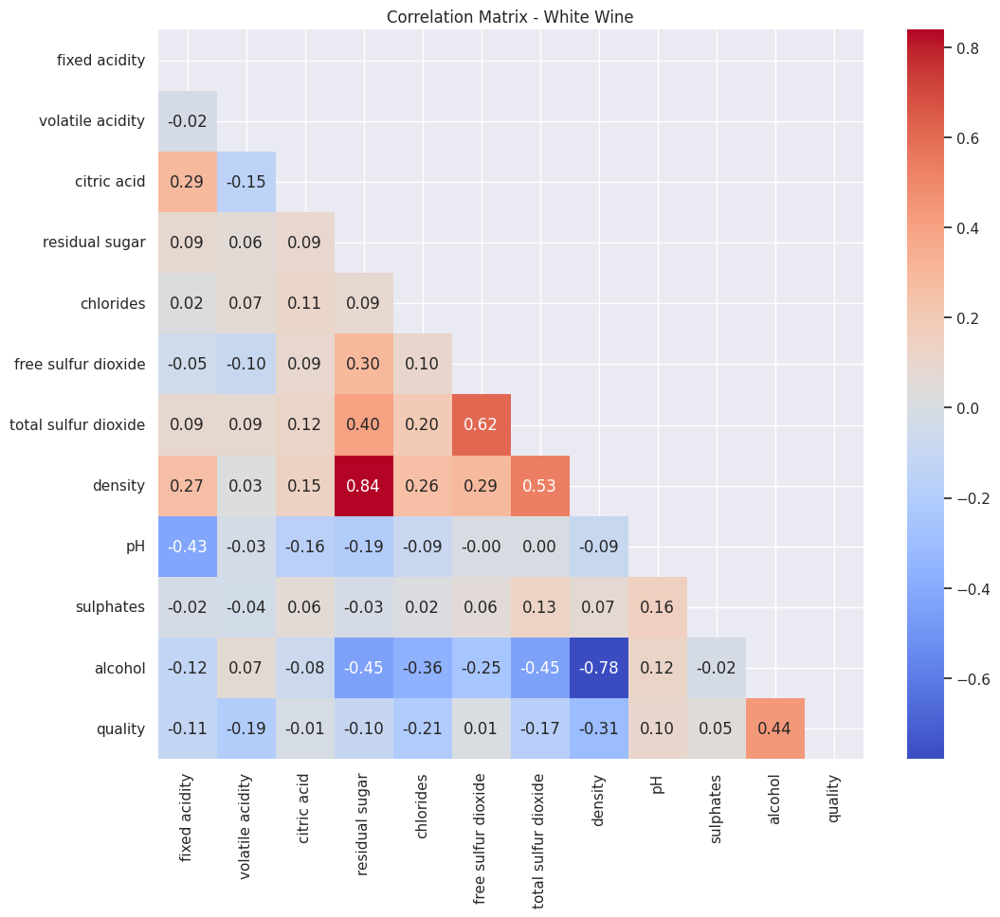

In [ ]:
## Correlation Matrix - White Wine
white_matriz = df_w.drop(columns=["Class"]).corr()
print(white_matriz)

mask = np.triu(np.ones_like(white_matriz, dtype=bool))

plt.figure(figsize=(12, 10))
sns.heatmap(white_matriz, mask=mask, annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Correlation Matrix - White Wine')

plt.show()


# **Item 5**
Unconditional multi-variate analysis of the predictors

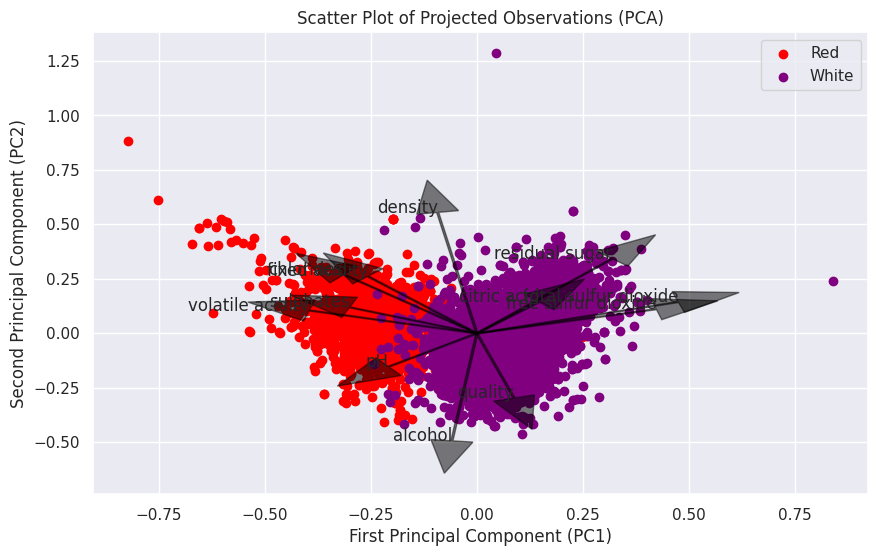

In [ ]:
# Normalize the data
scaler = StandardScaler()
X_std = scaler.fit_transform(combined_df.drop(columns=['Class']))
factor = 0.1
X_stdfac = X_std * factor

# Apply PCA
pca = PCA(n_components=2)
X_pca = pca.fit_transform(X_stdfac)
loadings = pca.components_.T
X_pca_with_labels = np.column_stack((X_pca, combined_df['Class'].values))

df_pca = pd.DataFrame(X_pca_with_labels, columns=['PC1', 'PC2', 'Class'])

plt.figure(figsize=(10, 6))
colors = {'Red': 'red', 'White': 'purple'}
for label, color in colors.items():
    subset = df_pca[df_pca['Class'] == label]
    plt.scatter(subset['PC1'], subset['PC2'], c=color, label=label)

for i, predictor in enumerate(combined_df.drop(columns=['Class']).columns):
    plt.arrow(0, 0, loadings[i, 0], loadings[i, 1], color='black', alpha=0.5, width=0.005, head_width=0.1)
    plt.text(loadings[i, 0], loadings[i, 1], predictor, fontsize=12, ha='right')

plt.xlabel('First Principal Component (PC1)')
plt.ylabel('Second Principal Component (PC2)')
plt.legend()
plt.title('Scatter Plot of Projected Observations (PCA)')
plt.show()


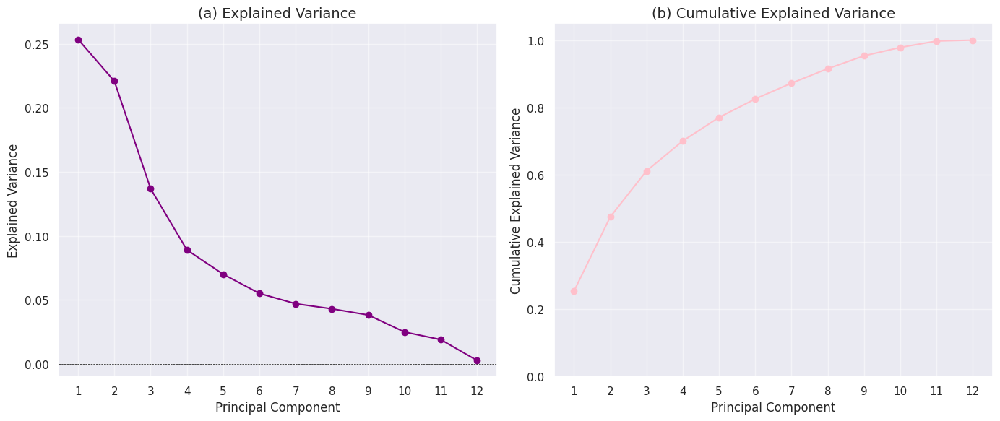

In [ ]:
X = combined_df.drop(columns=['Class']).values

# Normalize the data
scaler = StandardScaler()
X_std = scaler.fit_transform(X)

# Apply PCA
pca = PCA(n_components=X_std.shape[1])
X_pca = pca.fit_transform(X_std)

# Calculate explained variance and cumulative variance
explained_variance = pca.explained_variance_ratio_ 
cumulative_variance = np.cumsum(explained_variance)

plt.figure(figsize=(14, 6))

# Explained Variance
plt.subplot(1, 2, 1)
plt.plot(range(1, len(explained_variance) + 1), explained_variance, marker='o', linestyle='-', color='purple', label='Explained Variance')
plt.axhline(y=0, color='black', linestyle='--', linewidth=0.5)
plt.title("(a) Explained Variance", fontsize=14)
plt.xlabel("Principal Component", fontsize=12)
plt.ylabel("Explained Variance", fontsize=12)
plt.xticks(range(1, len(explained_variance) + 1))
plt.grid(alpha=0.5)

# Cumulative Explained Variance
plt.subplot(1, 2, 2)
plt.plot(range(1, len(cumulative_variance) + 1), cumulative_variance, marker='o', linestyle='-', color='pink', label='Cumulative Variance')
plt.title("(b) Cumulative Explained Variance", fontsize=14)
plt.xlabel("Principal Component", fontsize=12)
plt.ylabel("Cumulative Explained Variance", fontsize=12)
plt.xticks(range(1, len(cumulative_variance) + 1))
plt.ylim(0, 1.05)
plt.grid(alpha=0.5)

plt.tight_layout()
plt.show()
